In [1]:
import os
import cv2
import numpy as np
from glob import glob
from scipy.io import loadmat
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

In [36]:
CLASSES = [
    "фон",
    "гусли",
    "курительная трубка",
    "шкатулка",
    "меч",
    "шлем",
    "череп",
    "череп с венком",
    "книга",
    "перевёрнутый вниз стакан",
    "часы",
    "песочные часы",
    "ключ",
    "пустой стакан",
    "саквояж",
    "потухшая свеча",
    "мосркие раковины",
    "опавшая листва",
    "медецинские инструменты",
    "мыльный пузырь",
    "разбитая посуда",
    "ноты",
    "нож",
    "флейта",
    "кошель",
    "тюльпан",
    "роза",
    "ландыш",
    "фиалка",
    "лилия",
    "гвоздика",
    "нарцисс",
    "ирис",
    "вьюнок",
    "бабочка",
    "бокал с вином",
    "виноград",
    "вишня",
    "высокий бокал",
    "гранат",
    "инжир",
    "кубок-наутилоса",
    "лимон кусочком",
    "лимон с кожурой",
    "мясной пирог",
    "наклоненный/пустой бокал",
    "оливка",
    "открытая устрица",
    "персик",
    "улитка",
    "хлеб",
]

COLORMAP = [
    [0, 0, 0],
    [0, 113, 188],
    [216, 82, 24],
    [236, 176, 31],
    [125, 46, 141],
    [118, 171, 47],
    [161, 19, 46],
    [255, 0, 0],
    [255, 127, 0],
    [190, 190, 0],
    [ 0, 255, 0],
    [0, 0, 255],
    [170, 0, 255],
    [84, 84, 0],
    [84, 255, 0],
    [170, 84, 0],
    [170, 170, 0],
    [170, 255, 0],
    [255, 84, 0],
    [255, 170, 0],
    [255, 255, 0],
    [0, 84, 127],
    [0, 170, 127],
    [0, 255, 127],
    [84, 0, 127],
    [255, 106, 77],
    [250, 50, 83],
    [170, 240, 209],
    [140, 120, 240],
    [223, 236, 236],
    [253, 156, 204],
    [244, 244, 60],
    [91, 85, 144],
    [158, 158, 244],
    [240, 120, 240],
    [97, 7, 38],
    [131, 224, 112],
    [211, 0, 42],
    [15, 209, 123],
    [255, 0, 74],
    [228, 148, 95],
    [255, 204, 51],
    [197, 197, 0],
    [250, 250, 55],
    [204, 153, 51],
    [51, 221, 255],    
    [46, 160, 46],
    [61, 61, 245],
    [255, 204, 51],
    [102, 80, 207],
    [150, 85, 23],
]

IMAGE_SIZE = 512
BATCH_SIZE = 4
NUM_CLASSES = len(COLORMAP)
NUMBER = 1
DATA_DIR = [".\\skeletons\\", ".\\flowers\\", ".\\tables\\"]

train_images = sorted(glob(os.path.join(DATA_DIR[NUMBER], "train\\img/*")))
train_masks = sorted(glob(os.path.join(DATA_DIR[NUMBER], "train\\lbl/*")))
val_images = sorted(glob(os.path.join(DATA_DIR[NUMBER], "val\\img/*")))
val_masks = sorted(glob(os.path.join(DATA_DIR[NUMBER], "val\\lbl/*")))

In [3]:
def back(mask):
  return mask

class AugmentFlipRotate(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    self.augment_inputs = tf.keras.layers.RandomFlip("horizontal_and_vertical", seed=seed)
    self.augment_labels = tf.keras.layers.RandomFlip("horizontal_and_vertical", seed=seed)
    self.augment_inputs2 = tf.keras.layers.RandomRotation(0.2, seed=seed)
    self.augment_labels2 = tf.keras.layers.RandomRotation(0.2, seed=seed, interpolation='nearest')

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    inputs = self.augment_inputs2(inputs)
    labels = self.augment_labels2(labels)
    return inputs, labels
  
class AugmentContrast(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    self.augment_inputs = tf.keras.layers.RandomContrast([1.0, 10.0], seed=seed)
    self.augment_labels = back

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

class AugmentZoom(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    self.augment_inputs = tf.keras.layers.RandomZoom(.5, .2, seed=seed)
    self.augment_labels = tf.keras.layers.RandomZoom(.5, .2, interpolation='nearest', seed=seed)

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

class AugmentTranslation(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    self.augment_inputs = tf.keras.layers.RandomTranslation(height_factor=0.2, width_factor=0.2, fill_mode="constant", seed=seed)
    self.augment_labels = tf.keras.layers.RandomTranslation(height_factor=0.2, width_factor=0.2, fill_mode="constant", seed=seed, interpolation='nearest')

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels
  
class AugmentCrop(tf.keras.layers.Layer):
  def __init__(self, seed=1):
    super().__init__()
    self.augment_inputs = tf.keras.layers.RandomCrop(256, 256, seed=seed)
    self.augment_labels = tf.keras.layers.RandomCrop(256, 256, seed=seed)

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    inputs = tf.image.resize(images=inputs, size=[IMAGE_SIZE, IMAGE_SIZE])
    labels = tf.image.resize(images=labels, size=[IMAGE_SIZE, IMAGE_SIZE], method='nearest')
    return inputs, labels

In [4]:
def augment(images, masks):
  rimages, rmasks = [], []
  AFR = AugmentFlipRotate()
  ACt = AugmentContrast()
  AZ = AugmentZoom()
  AT = AugmentTranslation()
  ACp = AugmentCrop()
  for i in range(len(images)):
    rAFR = AFR(images[i], masks[i])
    rACt = ACt(images[i], masks[i])
    rAZ = AZ(images[i], masks[i])
    rAT = AT(images[i], masks[i])
    rACp = ACp(images[i], masks[i])
    rimages += [images[i], rAFR[0], rACt[0], rAZ[0], rAT[0], rACp[0]]
    rmasks += [masks[i], rAFR[1], rACt[1], rAZ[1], rAT[1], rACp[1]]
  return rimages, rmasks

def read_image(image_path, mask=False, presentation = False):
    print(image_path)
    if mask:
        image = cv2.imread(image_path, cv2.IMREAD_COLOR)
        image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE), interpolation=cv2.INTER_NEAREST)
        for x in range(len(image)):
            for y in range(len(image[x])):
                try:
                    buf = list(image[x][y])
                    buf.reverse()
                    image[x][y] = [COLORMAP.index(buf)]
                except ValueError:
                    image[x][y] = image[x][y-1]
        image = image[:, :,[0]]
        image = tf.convert_to_tensor(image, dtype="float32") 
    else:
        image = tf.io.read_file(image_path)
        image = tf.image.decode_png(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        if not(presentation):
            image = tf.keras.applications.resnet50.preprocess_input(image)
    return [image]

def data_generator(image_list, mask_list, validation = False):
    dataset = [[], []]
    for i in image_list:       
        dataset[0] += read_image(i)
    for j in mask_list:
        dataset[1] += read_image(j, mask=True)
    if not(validation):
        dataset[0], dataset[1] = augment(dataset[0], dataset[1])
    dataset = tf.data.Dataset.from_tensor_slices((dataset[0], dataset[1]))
    dataset = dataset.batch(BATCH_SIZE)
    return dataset

In [5]:
mask = tf.io.read_file('.\\tables\\train\\lbl\\38.png')
mask = tf.image.decode_png(mask)
mask.set_shape([None, None, 3])
mask = tf.image.resize(images=mask, size=[IMAGE_SIZE, IMAGE_SIZE], method='nearest')
image = tf.io.read_file('.\\tables\\train\\img\\38.jpg')
image = tf.image.decode_png(image, channels=3)
image.set_shape([None, None, 3])
image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE], method='nearest')
resultImages, resultMasks = augment([image], [mask])

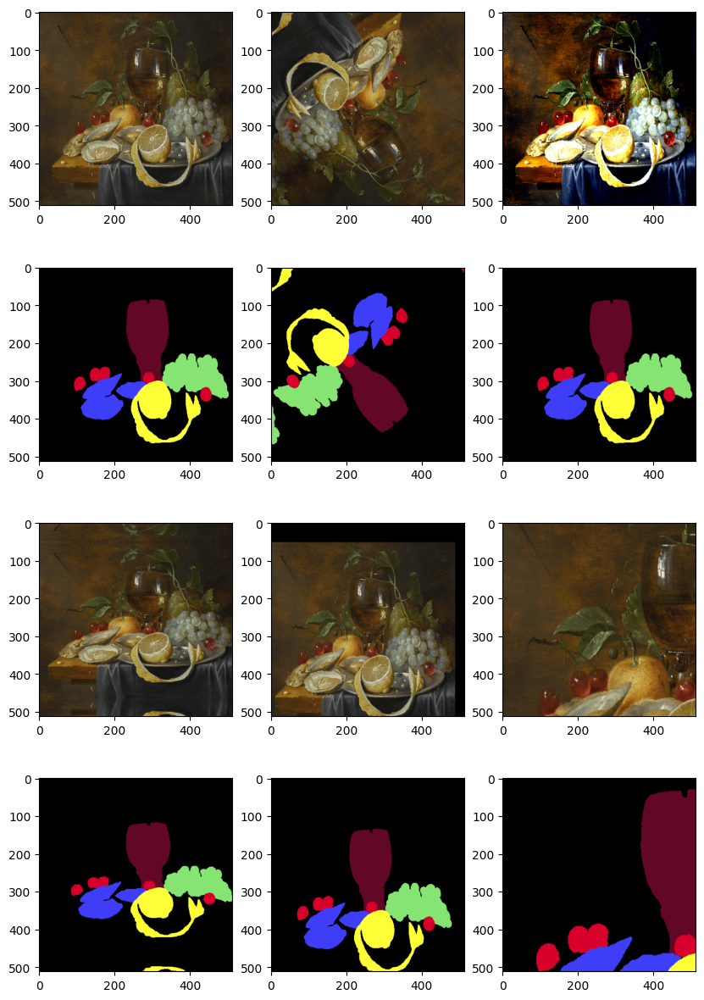

In [11]:
_, axs = plt.subplots(4, 3, figsize=(10, 15))
axs[0, 0].imshow(tf.keras.preprocessing.image.array_to_img(resultImages[0]))
axs[0, 1].imshow(tf.keras.preprocessing.image.array_to_img(resultImages[1]))
axs[0, 2].imshow(tf.keras.preprocessing.image.array_to_img(resultImages[2]))
axs[2, 0].imshow(tf.keras.preprocessing.image.array_to_img(resultImages[3]))
axs[2, 1].imshow(tf.keras.preprocessing.image.array_to_img(resultImages[4]))
axs[2, 2].imshow(tf.keras.preprocessing.image.array_to_img(resultImages[5]))
axs[1, 0].imshow(tf.keras.preprocessing.image.array_to_img(resultMasks[0]))
axs[1, 1].imshow(tf.keras.preprocessing.image.array_to_img(resultMasks[1]))
axs[1, 2].imshow(tf.keras.preprocessing.image.array_to_img(resultMasks[2]))
axs[3, 0].imshow(tf.keras.preprocessing.image.array_to_img(resultMasks[3]))
axs[3, 1].imshow(tf.keras.preprocessing.image.array_to_img(resultMasks[4]))
axs[3, 2].imshow(tf.keras.preprocessing.image.array_to_img(resultMasks[5]))
plt.show()

In [29]:
train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks, validation=True)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

.\skeletons\train\img\1.jpg
.\skeletons\train\img\10.jpg
.\skeletons\train\img\100.jpg
.\skeletons\train\img\101.jpeg
.\skeletons\train\img\11.jpg
.\skeletons\train\img\12.jpg
.\skeletons\train\img\13.jpg
.\skeletons\train\img\14.jpeg
.\skeletons\train\img\15.jpg
.\skeletons\train\img\16.jpg
.\skeletons\train\img\17.jpg
.\skeletons\train\img\18.jpeg
.\skeletons\train\img\19.jpg
.\skeletons\train\img\2.jpeg
.\skeletons\train\img\20.jpg
.\skeletons\train\img\22.jpg
.\skeletons\train\img\23.jpg
.\skeletons\train\img\24.jpg
.\skeletons\train\img\25.jpg
.\skeletons\train\img\26.jpg
.\skeletons\train\img\27.jpg
.\skeletons\train\img\28.jpg
.\skeletons\train\img\29.jpg
.\skeletons\train\img\3.jpeg
.\skeletons\train\img\30.jpg
.\skeletons\train\img\31.jpg
.\skeletons\train\img\32.jpg
.\skeletons\train\img\33.jpg
.\skeletons\train\img\34.jpg
.\skeletons\train\img\35.jpg
.\skeletons\train\img\36.jpg
.\skeletons\train\img\37.jpg
.\skeletons\train\img\39.jpg
.\skeletons\train\img\4.jpg
.\skeletons

In [7]:
def convolution_block(
    block_input,
    num_filters=256,
    kernel_size=3,
    dilation_rate=1,
    padding="same",
    use_bias=False,
):
    x = layers.Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer=keras.initializers.HeNormal(),
    )(block_input)
    x = layers.BatchNormalization()(x)
    return tf.nn.relu(x)


def DilatedSpatialPyramidPooling(dspp_input):
    dims = dspp_input.shape
    x = layers.AveragePooling2D(pool_size=(dims[-3], dims[-2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)
    out_pool = layers.UpSampling2D(
        size=(dims[-3] // x.shape[1], dims[-2] // x.shape[2]), interpolation="bilinear",
    )(x)

    out_1 = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6 = convolution_block(dspp_input, kernel_size=3, dilation_rate=6)
    out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    x = layers.Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = convolution_block(x, kernel_size=1)
    return output

In [8]:
def DeeplabV3Plus(image_size, num_classes):
    model_input = keras.Input(shape=(image_size, image_size, 3))
    resnet50 = keras.applications.ResNet50(
        weights="imagenet", include_top=False, input_tensor=model_input
    )
    x = resnet50.get_layer("conv4_block6_2_relu").output
    x = DilatedSpatialPyramidPooling(x)

    input_a = layers.UpSampling2D(
        size=(image_size // 4 // x.shape[1], image_size // 4 // x.shape[2]),
        interpolation="bilinear",
    )(x)
    input_b = resnet50.get_layer("conv2_block3_2_relu").output
    input_b = convolution_block(input_b, num_filters=48, kernel_size=1)

    x = layers.Concatenate(axis=-1)([input_a, input_b])
    x = convolution_block(x)
    x = convolution_block(x)
    x = layers.UpSampling2D(
        size=(image_size // x.shape[1], image_size // x.shape[2]),
        interpolation="bilinear",
    )(x)
    model_output = layers.Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)
    return keras.Model(inputs=model_input, outputs=model_output)

model = DeeplabV3Plus(image_size=IMAGE_SIZE, num_classes=NUM_CLASSES)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 518, 518, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 256, 256, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [9]:
class UpdatedIoU(tf.keras.metrics.IoU):
  def __init__(self,
               y_true=None,
               y_pred=None,
               num_classes=None,
               target_class_ids=None,
               name=None,
               dtype=None):
    super(UpdatedIoU, self).__init__(num_classes = num_classes, target_class_ids=target_class_ids, name=name, dtype=dtype)

  def update_state(self, y_true, y_pred, sample_weight=None):
    y_pred = tf.math.argmax(y_pred, axis=-1)
    return super().update_state(y_true, y_pred, sample_weight)


In [10]:
def grafics(history, iou):
    train_loss, val_loss, train_accuracy, val_accuracy, train_MIoU, val_MIoU = [], [], [], [], [], []
    for i in history:
        train_loss += i['loss']
        val_loss += i['val_loss']
        train_accuracy += i['accuracy']
        val_accuracy += i['val_accuracy']
        train_MIoU += i['MIoU']
        val_MIoU += i['val_MIoU']
    fig, axs = plt.subplots(1, 2, figsize=(12, 4))
    fig.suptitle('Показатели модели')
    axs[0].plot(train_loss, label = 'train loss', color = 'b')
    axs[0].plot(val_loss, label = 'val loss', color = 'r')
    axs[0].set_title("Loss")
    axs[0].set_ylabel("loss")
    axs[0].set_xlabel("epoch")
    axs[0].legend()
    axs[1].plot(train_accuracy, label = 'train accuracy', color = 'm')
    axs[1].plot(val_accuracy, label = 'val accuracy', color = 'y')
    axs[1].plot(train_MIoU, label = 'train IoU', color = 'c')
    axs[1].plot(val_MIoU, label = 'val IoU', color = 'g')
    axs[1].set_title("Accuracy and MIoU")
    axs[1].set_ylabel("accuracy")
    axs[1].set_xlabel("epoch")
    axs[1].legend()
    plt.show()

    values = list(iou.values())
    keys = list(iou.keys())
    for i in range(len(values)):
        values[i] = values[i][0]

    train_values = values[:len(values)//2]
    val_values = values[len(values)//2:]
    lbl_keys = keys[:len(keys)//2]

    train_values = train_values[3:]
    val_values = val_values[3:]
    lbl_keys = lbl_keys[3:]

    x_axis = np.arange(len(lbl_keys))

    plt.figure(figsize = (18, 8))
    plt.title('IoU по классам')
    plt.bar(x_axis-0.2, val_values, width=0.4, color='c', label='val')
    plt.bar(x_axis+0.2, train_values, width=0.4, color='b', label='train')
    plt.xticks(x_axis, lbl_keys, rotation=90)
    plt.legend()
    plt.show()

In [13]:
# model_flowers = keras.models.load_model('D:\\model_flowers')
# loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
# model_flowers.compile(
#     optimizer=keras.optimizers.Adadelta(learning_rate=1.),
#     loss=loss,
#     metrics=[
#         "accuracy", 
#         UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0] + list(range(25, 34)), name='MIoU'),
#     ],
# )

# history = model_flowers.fit(train_dataset, validation_data=val_dataset, epochs=20)

model_flowers.compile(
    optimizer=keras.optimizers.Adadelta(learning_rate=1.),
    loss=loss,
    metrics=[
        "accuracy", 
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0] + list(range(25, 27)) + list(range(29, 34)), name='MIoU'),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0], name=CLASSES[0]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[25], name=CLASSES[25]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[26], name=CLASSES[26]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[29], name=CLASSES[29]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[30], name=CLASSES[30]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[31], name=CLASSES[31]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[32], name=CLASSES[32]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[33], name=CLASSES[33]),
    ],
)

IoUPerClasses_flowers = model_flowers.fit(train_dataset, validation_data=val_dataset, epochs=1)

model_flowers.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    loss=loss,
    metrics=[
        "accuracy", 
    ],
)

model_flowers.save('D:\\model_flowers2')

143/143 [==============================] - 1305s 9s/step - loss: 0.0249 - accuracy: 0.9898 - MIoU: 0.9126 - фон: 0.9884 - тюльпан: 0.9391 - роза: 0.9458 - лилия: 0.8863 - гвоздика: 0.9241 - нарцисс: 0.8638 - ирис: 0.8958 - вьюнок: 0.8574 - val_loss: 0.2423 - val_accuracy: 0.9432 - val_MIoU: 0.6444 - val_фон: 0.9473 - val_тюльпан: 0.7190 - val_роза: 0.4754 - val_лилия: 0.3015 - val_гвоздика: 0.4757 - val_нарцисс: 0.7651 - val_ирис: 0.7032 - val_вьюнок: 0.7678


INFO:tensorflow:Assets written to: D:\model_flowers2\assets


INFO:tensorflow:Assets written to: D:\model_flowers2\assets


In [15]:
flower_history1 = {'loss': [0.31427881121635437, 0.21994301676750183, 0.16790920495986938, 0.12915797531604767, 0.10219822824001312, 0.0845700278878212, 0.06900293380022049, 0.05814410373568535, 0.051050104200839996, 0.04523841291666031, 0.04083859175443649, 0.03854161873459816, 0.03537357598543167, 0.03393445909023285, 0.031331803649663925, 0.029956834390759468, 0.02865520305931568, 0.02724245749413967, 0.026885654777288437, 0.025575194507837296], 'accuracy': [0.9138684868812561, 0.9326128959655762, 0.9470552206039429, 0.9581875801086426, 0.9660705327987671, 0.9711477160453796, 0.9758111238479614, 0.9791052937507629, 0.9811525344848633, 0.9831193685531616, 0.9843325018882751, 0.9851931929588318, 0.9861986637115479, 0.9867979884147644, 0.9875072836875916, 0.9879888296127319, 0.988513171672821, 0.9889550805091858, 0.9891461133956909, 0.9895757436752319], 'MIoU': [0.28923624753952026, 0.3667616844177246, 0.44288235902786255, 0.5238516926765442, 0.5806543231010437, 0.6268180012702942, 0.6723650693893433, 0.7086299657821655, 0.7316312193870544, 0.7588614225387573, 0.7850433588027954, 0.7987844944000244, 0.825223445892334, 0.8323694467544556, 0.8407334089279175, 0.8441993594169617, 0.8523384928703308, 0.856170654296875, 0.8554424047470093, 0.8573940396308899], 'val_loss': [0.19666163623332977, 0.18798843026161194, 0.1998419314622879, 0.22248461842536926, 0.18716463446617126, 0.22219343483448029, 0.18913543224334717, 0.1624106615781784, 0.1606883555650711, 0.1791922003030777, 0.17166581749916077, 0.20063099265098572, 0.19943156838417053, 0.2516632080078125, 0.18776598572731018, 0.24242010712623596, 0.2272198498249054, 0.25949978828430176, 0.2168569564819336, 0.2434803992509842], 'val_accuracy': [0.9335289001464844, 0.9352348446846008, 0.9295463562011719, 0.9224601984024048, 0.9390945434570312, 0.9363258481025696, 0.9342033267021179, 0.9461555480957031, 0.9468895196914673, 0.9472267031669617, 0.9506744146347046, 0.943798840045929, 0.9464782476425171, 0.9390090703964233, 0.9477272033691406, 0.9399994015693665, 0.9434463381767273, 0.9398094415664673, 0.9476906061172485, 0.9434928894042969], 'val_MIoU': [0.37493059039115906, 0.42771846055984497, 0.4335605502128601, 0.36136484146118164, 0.44690388441085815, 0.3879902958869934, 0.5097373723983765, 0.4623560905456543, 0.5091822743415833, 0.5119839906692505, 0.47612372040748596, 0.5027644038200378, 0.5197415947914124, 0.489022821187973, 0.5333976149559021, 0.5298331379890442, 0.5290433764457703, 0.5132411122322083, 0.5517185926437378, 0.5112441778182983]}
flower_history1_1 = {'loss': [0.024692626670002937], 'accuracy': [0.9899038076400757], 'MIoU': [0.8701097369194031], 'фон': [0.9885423183441162], 'тюльпан': [0.9403509497642517], 'роза': [0.9463309049606323], 'ландыш': [0.6935303211212158], 'фиалка': [0.7050317525863647], 'лилия': [0.8872947096824646], 'гвоздика': [0.9240768551826477], 'нарцисс': [0.8616178035736084], 'ирис': [0.9006795287132263], 'вьюнок': [0.8536424040794373], 'val_loss': [0.22544756531715393], 'val_accuracy': [0.9458053708076477], 'val_MIoU': [0.5404740571975708], 'val_фон': [0.948911726474762], 'val_тюльпан': [0.7787582278251648], 'val_роза': [0.4857392907142639], 'val_ландыш': [0.08560924232006073], 'val_фиалка': [0.022007042542099953], 'val_лилия': [0.32596442103385925], 'val_гвоздика': [0.4547503888607025], 'val_нарцисс': [0.802692711353302], 'val_ирис': [0.7023562788963318], 'val_вьюнок': [0.797950804233551]}
flower_history2_1 = {'loss': [0.024927526712417603], 'accuracy': [0.98975670337677], 'MIoU': [0.9125798940658569], 'фон': [0.9883728623390198], 'тюльпан': [0.9390700459480286], 'роза': [0.9458163976669312], 'лилия': [0.8863181471824646], 'гвоздика': [0.9241002202033997], 'нарцисс': [0.8637583255767822], 'ирис': [0.89579176902771], 'вьюнок': [0.8574115037918091], 'val_loss': [0.24232491850852966], 'val_accuracy': [0.9432449340820312], 'val_MIoU': [0.6443668007850647], 'val_фон': [0.9472528696060181], 'val_тюльпан': [0.7189533710479736], 'val_роза': [0.4754221439361572], 'val_лилия': [0.3014541268348694], 'val_гвоздика': [0.47570884227752686], 'val_нарцисс': [0.7651463747024536], 'val_ирис': [0.7031670808792114], 'val_вьюнок': [0.7678294777870178]}

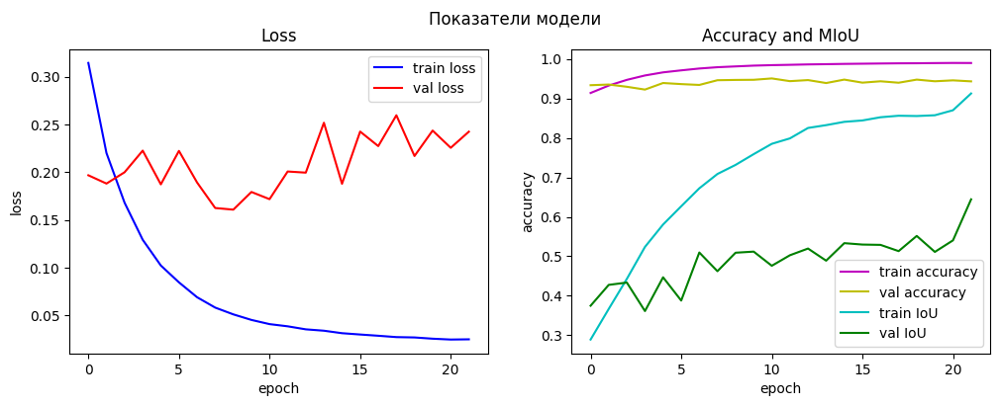

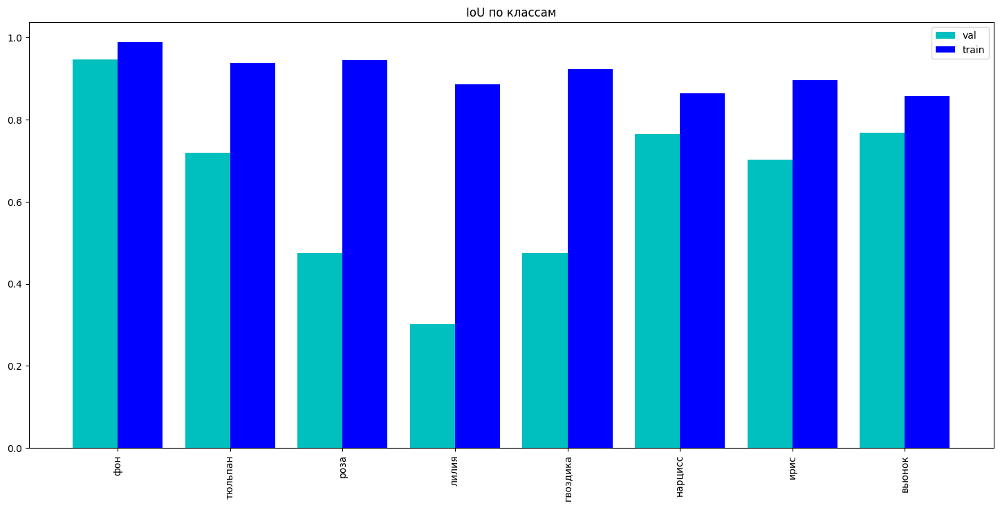

In [16]:
grafics([flower_history1, flower_history1_1, flower_history2_1], flower_history2_1)

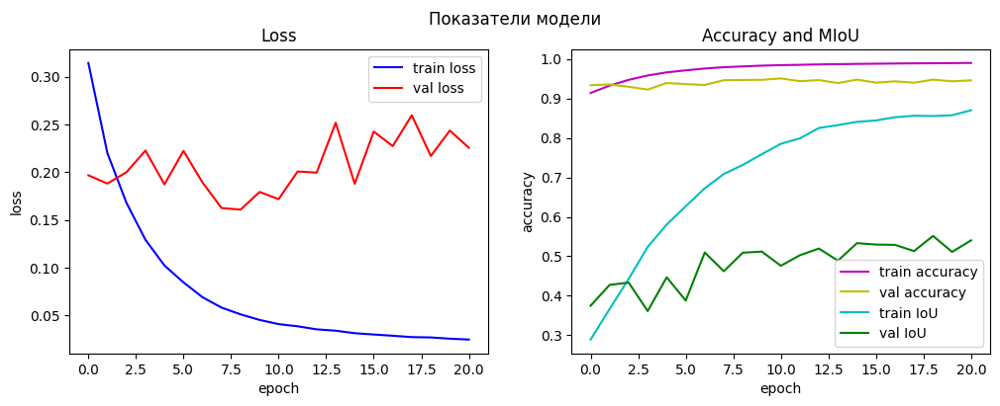

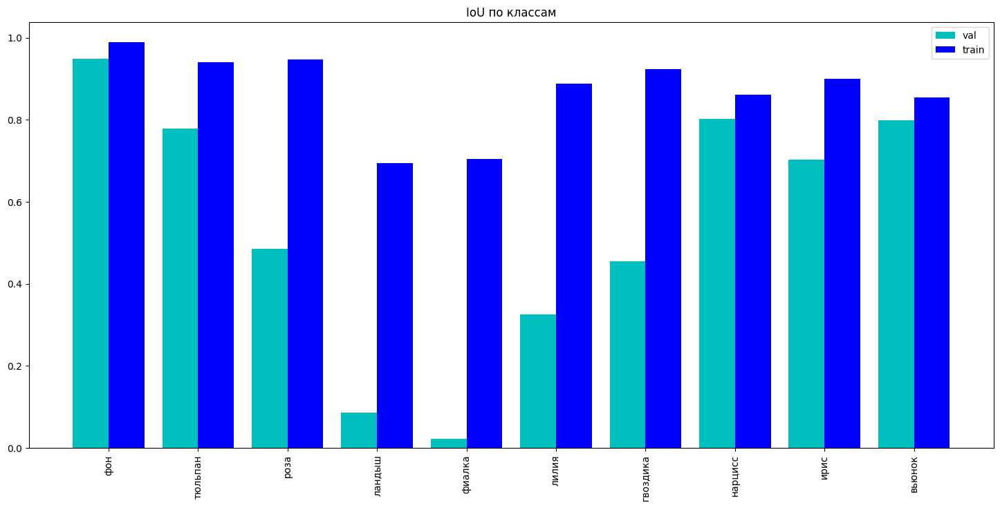

In [17]:
grafics([flower_history1, flower_history1_1], flower_history1_1)

In [11]:
model_tables = keras.models.load_model('D:\\model_tables3')
loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
model_tables.compile(
    optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
    loss=loss,
    metrics=[
        "accuracy", 
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0, 22] + list(range(34, 51)), name='MIoU'),
    ],
)

history = model_tables.fit(train_dataset, validation_data=val_dataset, epochs=10)

Epoch 1/10
149/149 [==============================] - 1345s 9s/step - loss: 0.0398 - accuracy: 0.9858 - MIoU: 0.8359 - val_loss: 0.6420 - val_accuracy: 0.9131 - val_MIoU: 0.3600
Epoch 2/10
149/149 [==============================] - 1341s 9s/step - loss: 0.0271 - accuracy: 0.9895 - MIoU: 0.8711 - val_loss: 0.6400 - val_accuracy: 0.9162 - val_MIoU: 0.3794
Epoch 3/10
149/149 [==============================] - 1313s 9s/step - loss: 0.0234 - accuracy: 0.9907 - MIoU: 0.8855 - val_loss: 0.6368 - val_accuracy: 0.9181 - val_MIoU: 0.3878
Epoch 4/10
149/149 [==============================] - 1302s 9s/step - loss: 0.0216 - accuracy: 0.9913 - MIoU: 0.8936 - val_loss: 0.6452 - val_accuracy: 0.9191 - val_MIoU: 0.3913
Epoch 5/10
149/149 [==============================] - 1305s 9s/step - loss: 0.0204 - accuracy: 0.9917 - MIoU: 0.8997 - val_loss: 0.6569 - val_accuracy: 0.9192 - val_MIoU: 0.3922
Epoch 6/10
149/149 [==============================] - 1297s 9s/step - loss: 0.0196 - accuracy: 0.9921 - MIoU: 

In [22]:
model_tables = keras.models.load_model('D:\\model_tables2')
model_tables.compile(
    optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
    loss=loss,
    metrics=[
        "accuracy", 
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0, 22] + list(range(35, 38)) + [39, 42, 43, 47, 50], name='MIoU'),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0], name=CLASSES[0]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[22], name=CLASSES[22]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[35], name=CLASSES[35]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[36], name=CLASSES[36]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[37], name=CLASSES[37]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[39], name=CLASSES[39]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[42], name=CLASSES[42]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[43], name=CLASSES[43]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[47], name=CLASSES[47]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[50], name=CLASSES[50]),
    ],
)

IoUPerClasses_tables = model_tables.fit(train_dataset, validation_data=val_dataset, epochs=1)

model_tables.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    loss=loss,
    metrics=[
        "accuracy", 
    ],
)

model_tables.save('D:\\model_tables4')

149/149 [==============================] - 1344s 9s/step - loss: 0.0167 - accuracy: 0.9932 - MIoU: 0.9327 - фон: 0.9924 - нож: 0.8464 - бокал с вином: 0.9642 - виноград: 0.9442 - вишня: 0.8726 - гранат: 0.9453 - лимон кусочком: 0.9044 - лимон с кожурой: 0.9499 - открытая устрица: 0.9449 - хлеб: 0.9630 - val_loss: 0.7328 - val_accuracy: 0.9194 - val_MIoU: 0.6571 - val_фон: 0.9127 - val_нож: 0.5761 - val_бокал с вином: 0.7200 - val_виноград: 0.7502 - val_вишня: 0.8031 - val_гранат: 0.6881 - val_лимон кусочком: 0.2328 - val_лимон с кожурой: 0.5912 - val_открытая устрица: 0.5926 - val_хлеб: 0.7042


INFO:tensorflow:Assets written to: D:\model_tables4\assets


INFO:tensorflow:Assets written to: D:\model_tables4\assets


In [25]:
tables_history1 = {'loss': [0.7351939082145691, 0.47543156147003174, 0.4195166230201721, 0.3718770742416382, 0.3438745141029358, 0.30367138981819153, 0.2768245339393616, 0.24156451225280762, 0.21540571749210358, 0.18547546863555908, 0.1604444533586502, 0.1371932476758957, 0.12302406132221222, 0.10749613493680954], 'accuracy': [0.8380337953567505, 0.8718730211257935, 0.8862599730491638, 0.8971425294876099, 0.903045117855072, 0.9116976261138916, 0.9178844094276428, 0.9265947341918945, 0.9340234398841858, 0.9414499998092651, 0.9482277035713196, 0.9555078148841858, 0.9590129256248474, 0.9638433456420898], 'MIoU': [0.06151194870471954, 0.08730584383010864, 0.1084672212600708, 0.12446194142103195, 0.13784876465797424, 0.16008788347244263, 0.18775314092636108, 0.22463423013687134, 0.2666756808757782, 0.31373894214630127, 0.3668120205402374, 0.4409928321838379, 0.471061110496521, 0.5265601873397827], 'val_loss': [0.9882723689079285, 0.6252714991569519, 0.5292953252792358, 0.46987828612327576, 0.5110847353935242, 0.47779369354248047, 0.5434293746948242, 0.49532270431518555, 0.5944000482559204, 0.6667630076408386, 0.5513702630996704, 0.4984550476074219, 0.4237058162689209, 0.48203831911087036], 'val_accuracy': [0.7045219540596008, 0.8092796206474304, 0.8615821599960327, 0.8750068545341492, 0.8686820864677429, 0.8844360113143921, 0.8788459897041321, 0.8828018307685852, 0.8750885128974915, 0.8593086004257202, 0.8749443292617798, 0.88885498046875, 0.8992019891738892, 0.885846734046936], 'val_MIoU': [0.08599049597978592, 0.11156564205884933, 0.15130671858787537, 0.1747983992099762, 0.171830952167511, 0.2132599651813507, 0.1838207244873047, 0.21254564821720123, 0.1829519271850586, 0.17861899733543396, 0.24225889146327972, 0.25348371267318726, 0.32041043043136597, 0.2717078626155853]} 
tables_history1_1 = {'loss': [0.1028953567147255], 'accuracy': [0.9651536345481873], 'MIoU': [0.5410735607147217], 'фон': [0.9632760286331177], 'нож': [0.3279220759868622], 'бабочка': [0.10063699632883072], 'бокал с вином': [0.8366483449935913], 'виноград': [0.7637264132499695], 'вишня': [0.45514002442359924], 'высокий бокал': [0.4414356052875519], 'гранат': [0.6058038473129272], 'инжир': [0.3023299276828766], 'кубок-наутилоса': [0.6912447214126587], 'лимон кусочком': [0.46552786231040955], 'лимон с кожурой': [0.8063560724258423], 'мясной пирог': [0.5759515762329102], 'наклоненный/пустой бокал': [0.654556155204773], 'оливка': [0.28981301188468933], 'открытая устрица': [0.6757570505142212], 'персик': [0.0], 'улитка': [0.0], 'хлеб': [0.783198893070221], 'val_loss': [0.5363450050354004], 'val_accuracy': [0.8713356256484985], 'val_MIoU': [0.25210675597190857], 'val_фон': [0.8761234283447266], 'val_нож': [0.349574476480484], 'val_бабочка': [0.0], 'val_бокал с вином': [0.5976109504699707], 'val_виноград': [0.6316210031509399], 'val_вишня': [0.3591451644897461], 'val_высокий бокал': [0.0], 'val_гранат': [0.09010129421949387], 'val_инжир': [0.0], 'val_кубок-наутилоса': [0.011735029518604279], 'val_лимон кусочком': [0.008507190272212029], 'val_лимон с кожурой': [0.47708776593208313], 'val_мясной пирог': [0.23795992136001587], 'val_наклоненный/пустой бокал': [0.002296245424076915], 'val_оливка': [0.0], 'val_открытая устрица': [0.3060016930103302], 'val_персик': [0.0], 'val_улитка': [0.0], 'val_хлеб': [0.3380507230758667]}
tables_history2 = {'loss': [0.06312884390354156, 0.06096767261624336, 0.058494966477155685, 0.04865455999970436, 0.04216451942920685, 0.037001412361860275, 0.03637487068772316, 0.03442619368433952, 0.034917570650577545, 0.033592719584703445], 'accuracy': [0.976739227771759, 0.977834165096283, 0.9784655570983887, 0.9818543791770935, 0.9840605854988098, 0.9857240319252014, 0.9860819578170776, 0.9867289662361145, 0.9866212606430054, 0.9870576858520508], 'MIoU': [0.6982025504112244, 0.7315890789031982, 0.750045895576477, 0.7688546776771545, 0.797559380531311, 0.8250823020935059, 0.8265443444252014, 0.8394401669502258, 0.8377101421356201, 0.8451060056686401], 'val_loss': [0.5628107190132141, 0.5286169648170471, 0.4967275559902191, 0.5214871168136597, 0.49588823318481445, 0.5221050977706909, 0.5770556926727295, 0.5463547706604004, 0.5376375317573547, 0.8211520910263062], 'val_accuracy': [0.9055038690567017, 0.91046142578125, 0.9036720395088196, 0.912823498249054, 0.9180328249931335, 0.9069427251815796, 0.9157485961914062, 0.9189003109931946, 0.9176216125488281, 0.9009445309638977], 'val_MIoU': [0.3289070427417755, 0.33521541953086853, 0.3229474723339081, 0.3553200960159302, 0.35921671986579895, 0.3559885323047638, 0.36117270588874817, 0.3907019793987274, 0.3828336298465729, 0.31038138270378113]} 
tables_history2_1 = {'loss': [0.037070151418447495], 'accuracy': [0.9858474731445312], 'MIoU': [0.8294541835784912], 'фон': [0.9842994213104248], 'нож': [0.7008494138717651], 'бабочка': [0.7268288731575012], 'бокал с вином': [0.9250710606575012], 'виноград': [0.880721390247345], 'вишня': [0.7620842456817627], 'высокий бокал': [0.8233043551445007], 'гранат': [0.8722673654556274], 'инжир': [0.7243790030479431], 'кубок-наутилоса': [0.9039697051048279], 'лимон кусочком': [0.787915825843811], 'лимон с кожурой': [0.9204913973808289], 'мясной пирог': [0.8673270344734192], 'наклоненный/пустой бокал': [0.8865639567375183], 'оливка': [0.6937155723571777], 'открытая устрица': [0.8677123188972473], 'персик': [0.0], 'улитка': [0.6749415993690491], 'хлеб': [0.9277328848838806], 'val_loss': [0.7941266298294067], 'val_accuracy': [0.8993690609931946], 'val_MIoU': [0.32049861550331116], 'val_фон': [0.8964148759841919], 'val_нож': [0.43419337272644043], 'val_бабочка': [0.0], 'val_бокал с вином': [0.5932003259658813], 'val_виноград': [0.6495375633239746], 'val_вишня': [0.31387266516685486], 'val_высокий бокал': [0.0], 'val_гранат': [0.7565863728523254], 'val_инжир': [0.0], 'val_кубок-наутилоса': [0.2170177400112152], 'val_лимон кусочком': [0.20893484354019165], 'val_лимон с кожурой': [0.4806022346019745], 'val_мясной пирог': [0.005815885495394468], 'val_наклоненный/пустой бокал': [0.0], 'val_оливка': [0.0], 'val_открытая устрица': [0.2009405791759491], 'val_персик': [0.0], 'val_улитка': [0.0], 'val_хлеб': [0.6913599967956543]}
tables_history3 = {'loss': [0.03984678164124489, 0.027081843465566635, 0.023439981043338776, 0.02161017246544361, 0.020426422357559204, 0.019564511254429817, 0.0188828743994236, 0.018316682428121567, 0.017832444980740547, 0.017409997060894966], 'accuracy': [0.9858444929122925, 0.9895270466804504, 0.9906861782073975, 0.9913134574890137, 0.9917455315589905, 0.9920688271522522, 0.992327868938446, 0.9925457835197449, 0.9927332997322083, 0.9928936958312988], 'MIoU': [0.8359497785568237, 0.8711397051811218, 0.8854880928993225, 0.8935672044754028, 0.8996831178665161, 0.904137372970581, 0.9077374339103699, 0.9107332229614258, 0.9131398797035217, 0.9152739644050598], 'val_loss': [0.6420295834541321, 0.639996349811554, 0.6367577314376831, 0.6451840400695801, 0.6568515300750732, 0.6672083735466003, 0.6826192140579224, 0.6962140202522278, 0.7046478986740112, 0.7150036096572876], 'val_accuracy': [0.9131423830986023, 0.9161842465400696, 0.9181068539619446, 0.9190627932548523, 0.9191566705703735, 0.9194275140762329, 0.9192489385604858, 0.9192894101142883, 0.9195564389228821, 0.9194625616073608], 'val_MIoU': [0.3600189983844757, 0.3794114291667938, 0.387821763753891, 0.39130908250808716, 0.39224690198898315, 0.3932052254676819, 0.3925558030605316, 0.39193493127822876, 0.39228320121765137, 0.391152948141098]} 
tables_history3_1 = {'loss': [0.01703270524740219], 'accuracy': [0.9930398464202881], 'MIoU': [0.9171087741851807], 'фон': [0.9922053813934326], 'нож': [0.8425031304359436], 'бабочка': [0.8534607887268066], 'бокал с вином': [0.9634172320365906], 'виноград': [0.943204939365387], 'вишня': [0.8706974983215332], 'высокий бокал': [0.9382922053337097], 'гранат': [0.9441559910774231], 'инжир': [0.9076319336891174], 'кубок-наутилоса': [0.9536726474761963], 'лимон кусочком': [0.9026761651039124], 'лимон с кожурой': [0.9493077397346497], 'мясной пирог': [0.9341123700141907], 'наклоненный/пустой бокал': [0.9521647095680237], 'оливка': [0.8323953151702881], 'открытая устрица': [0.9438303112983704], 'персик': [0.0], 'улитка': [0.8218439817428589], 'хлеб': [0.9623856544494629], 'val_loss': [0.7240756750106812], 'val_accuracy': [0.9194046258926392], 'val_MIoU': [0.39033716917037964], 'val_фон': [0.9126687049865723], 'val_нож': [0.587068498134613], 'val_бабочка': [0.0], 'val_бокал с вином': [0.7202848196029663], 'val_виноград': [0.7496979236602783], 'val_вишня': [0.8026030659675598], 'val_высокий бокал': [0.0], 'val_гранат': [0.6861560344696045], 'val_инжир': [0.0], 'val_кубок-наутилоса': [0.053630318492650986], 'val_лимон кусочком': [0.23398542404174805], 'val_лимон с кожурой': [0.5914106965065002], 'val_мясной пирог': [0.0], 'val_наклоненный/пустой бокал': [0.0], 'val_оливка': [0.0], 'val_открытая устрица': [0.594537615776062], 'val_персик': [0.0], 'val_улитка': [0.0], 'val_хлеб': [0.7036888599395752]}
tables_history4_1 = {'loss': [0.016694016754627228], 'accuracy': [0.9931727051734924], 'MIoU': [0.9327384829521179], 'фон': [0.9923543334007263], 'нож': [0.8464327454566956], 'бокал с вином': [0.9641848802566528], 'виноград': [0.9442100524902344], 'вишня': [0.8726214170455933], 'гранат': [0.9453173279762268], 'лимон кусочком': [0.904431164264679], 'лимон с кожурой': [0.9499424695968628], 'открытая устрица': [0.9448842406272888], 'хлеб': [0.963006317615509], 'val_loss': [0.7328122854232788], 'val_accuracy': [0.9194008111953735], 'val_MIoU': [0.6571004390716553], 'val_фон': [0.9127203226089478], 'val_нож': [0.5760617852210999], 'val_бокал с вином': [0.7200412750244141], 'val_виноград': [0.7502275109291077], 'val_вишня': [0.8030919432640076], 'val_гранат': [0.688110888004303], 'val_лимон кусочком': [0.2327619045972824], 'val_лимон с кожурой': [0.5911808609962463], 'val_открытая устрица': [0.5926331877708435], 'val_хлеб': [0.7041744589805603]}

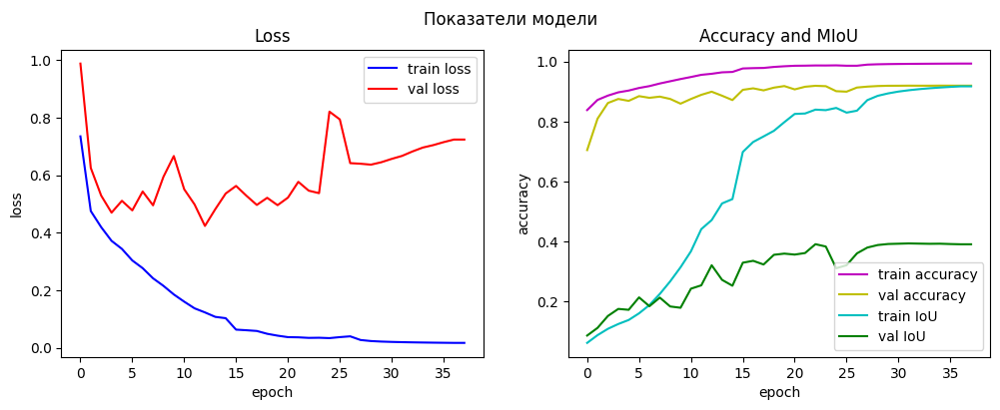

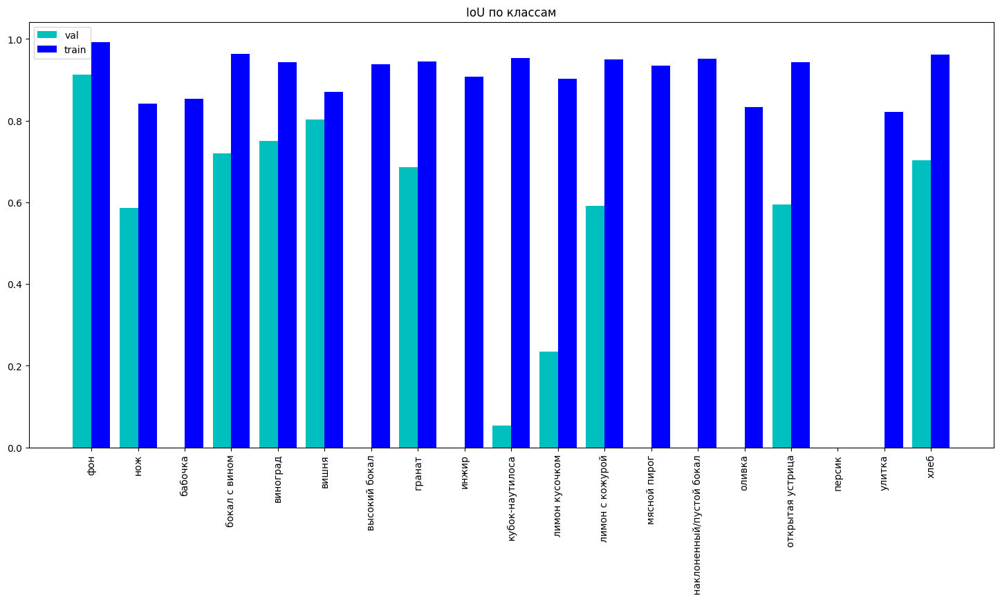

In [37]:
grafics([tables_history1, tables_history1_1, tables_history2, tables_history2_1, tables_history3, tables_history3_1], tables_history3_1)

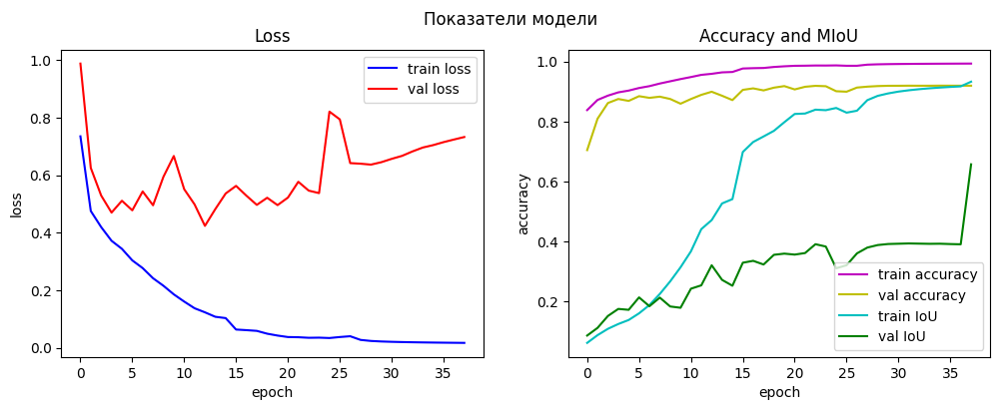

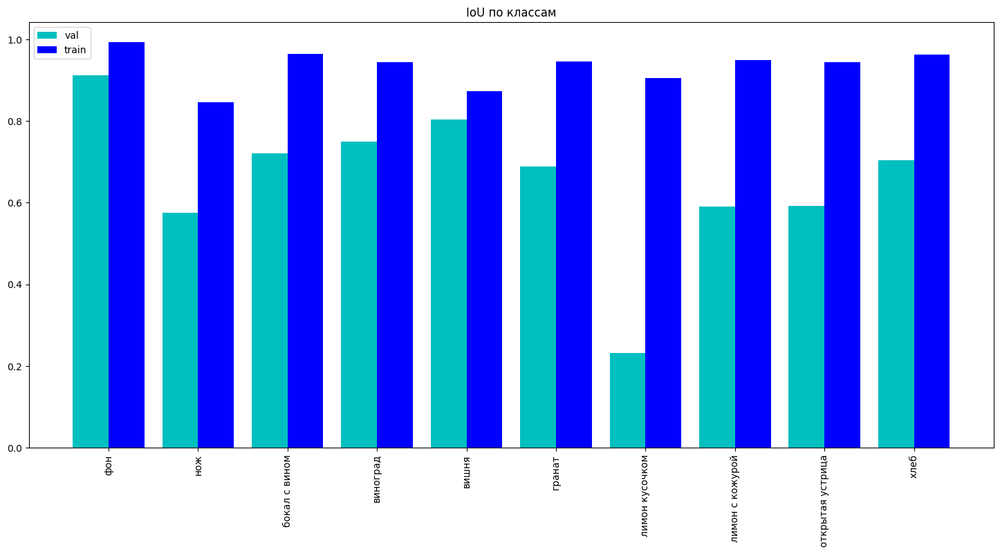

In [26]:
grafics([tables_history1, tables_history1_1, tables_history2, tables_history2_1, tables_history3, tables_history3_1, tables_history4_1], tables_history4_1)

In [30]:
model_skeletons = keras.models.load_model('D:\\model_skeletons2')
loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
# model_skeletons.compile(
#     optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
#     loss=loss,
#     metrics=[
#         "accuracy", 
#         UpdatedIoU(num_classes=len(CLASSES), target_class_ids=list(range(0, 25)), name='MIoU'),
#     ],
# )

# history = model_skeletons.fit(train_dataset, validation_data=val_dataset, epochs=20)

model_skeletons.compile(
    optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
    loss=loss,
    metrics=[
        "accuracy", 
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0, 6, 7, 8, 10, 21], name='MIoU'),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0], name=CLASSES[0]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[6], name=CLASSES[6]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[7], name=CLASSES[7]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[8], name=CLASSES[8]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[10], name=CLASSES[10]),
        UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[21], name=CLASSES[21]),
    ],
)

IoUPerClasses_skeletons = model_skeletons.fit(train_dataset, validation_data=val_dataset, epochs=1)

model_skeletons.compile(
    optimizer=keras.optimizers.RMSprop(learning_rate=0.001),
    loss=loss,
    metrics=[
        "accuracy"
    ],
)

model_skeletons.save('D:\\model_skeletons3')

146/146 [==============================] - ETA: 0s - loss: 0.0233 - accuracy: 0.9908 - MIoU: 0.9595 - фон: 0.9889 - череп: 0.9783 - череп с венком: 0.9402 - книга: 0.9575 - часы: 0.9355 - ноты: 0.9568WARNING:tensorflow:5 out of the last 47 calls to <function Model.make_test_function.<locals>.test_function at 0x000001E076707280> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


146/146 [==============================] - 1316s 9s/step - loss: 0.0233 - accuracy: 0.9908 - MIoU: 0.9595 - фон: 0.9889 - череп: 0.9783 - череп с венком: 0.9402 - книга: 0.9575 - часы: 0.9355 - ноты: 0.9568 - val_loss: 1.5290 - val_accuracy: 0.8317 - val_MIoU: 0.5195 - val_фон: 0.8366 - val_череп: 0.8159 - val_череп с венком: 0.6176 - val_книга: 0.1929 - val_часы: 0.5977 - val_ноты: 0.0563


INFO:tensorflow:Assets written to: D:\model_skeletons3\assets


INFO:tensorflow:Assets written to: D:\model_skeletons3\assets


In [32]:
skeleton_history1 = {'loss': [1.0121105909347534, 0.7472479343414307, 0.6670140027999878, 0.5921074748039246, 0.5326017141342163, 0.4723412096500397, 0.41636747121810913, 0.37043896317481995, 0.3171422779560089, 0.2621263861656189], 'accuracy': [0.7685843706130981, 0.805364191532135, 0.8213713765144348, 0.8373831510543823, 0.849032461643219, 0.8630900979042053, 0.8769324421882629, 0.8887834548950195, 0.9008533954620361, 0.9186815619468689], 'MIoU': [0.04805689677596092, 0.058102864772081375, 0.0740143209695816, 0.09094475954771042, 0.11399412155151367, 0.14399442076683044, 0.1848856508731842, 0.2159550040960312, 0.26244065165519714, 0.3215912878513336], 'val_loss': [1.4195191860198975, 0.853196918964386, 0.9670981168746948, 0.8617333173751831, 0.9365646243095398, 1.175606608390808, 0.9803441762924194, 1.0287119150161743, 1.071062445640564, 0.957470178604126], 'val_accuracy': [0.7646360397338867, 0.8147430419921875, 0.8003835678100586, 0.8127613067626953, 0.8087940216064453, 0.7575283050537109, 0.8069076538085938, 0.8201475143432617, 0.8163204193115234, 0.8145027160644531], 'val_MIoU': [0.08797310292720795, 0.11287281662225723, 0.09186539798974991, 0.11251953989267349, 0.11028487235307693, 0.10281594842672348, 0.1277341991662979, 0.1395319104194641, 0.13713087141513824, 0.13871078193187714]}
skeleton_history2 = {'loss': [0.19197115302085876, 0.1608632653951645, 0.13930277526378632, 0.11748781055212021, 0.11098245531320572, 0.09624259173870087, 0.07696770876646042, 0.06372512131929398, 0.060909271240234375, 0.05490011349320412, 0.050159454345703125, 0.04875274375081062, 0.041328273713588715, 0.03708163648843765, 0.03439544513821602, 0.03210638463497162, 0.03004816360771656, 0.02809307910501957, 0.026832055300474167, 0.026583993807435036], 'accuracy': [0.9407294988632202, 0.9493287801742554, 0.9564325213432312, 0.9621602892875671, 0.9634827375411987, 0.9684602618217468, 0.9743048548698425, 0.9784688353538513, 0.979089081287384, 0.980724036693573, 0.9822339415550232, 0.9832225441932678, 0.9848752617835999, 0.9862214922904968, 0.9870949387550354, 0.9877844452857971, 0.9883780479431152, 0.9890972375869751, 0.989555835723877, 0.989709198474884], 'MIoU': [0.41894832253456116, 0.4674607515335083, 0.5102500319480896, 0.5599681735038757, 0.5881553888320923, 0.6390444040298462, 0.6940618753433228, 0.7404329776763916, 0.7686709761619568, 0.7908156514167786, 0.8119994401931763, 0.8102902173995972, 0.8343753218650818, 0.8518091440200806, 0.8693027496337891, 0.8725394606590271, 0.8757371306419373, 0.8860691785812378, 0.8897997140884399, 0.8920443058013916], 'val_loss': [1.1506601572036743, 1.2942626476287842, 1.2276897430419922, 1.192527413368225, 1.2412790060043335, 1.536091685295105, 1.1386150121688843, 1.4954551458358765, 1.3342033624649048, 1.4392714500427246, 1.7252558469772339, 1.146600604057312, 1.9129719734191895, 1.4875677824020386, 1.7485506534576416, 1.4367676973342896, 1.542463779449463, 1.491943359375, 1.5802807807922363, 1.4632235765457153], 'val_accuracy': [0.8199901580810547, 0.8244390487670898, 0.8363723754882812, 0.8048315048217773, 0.8278694152832031, 0.8277978897094727, 0.8398590087890625, 0.8318452835083008, 0.8360815048217773, 0.8283500671386719, 0.8298330307006836, 0.8321809768676758, 0.8296012878417969, 0.830113410949707, 0.8293256759643555, 0.8274831771850586, 0.8348484039306641, 0.8231306076049805, 0.8304595947265625, 0.8257236480712891], 'val_MIoU': [0.16658107936382294, 0.14434325695037842, 0.17305539548397064, 0.14613045752048492, 0.14016330242156982, 0.12664061784744263, 0.16401620209217072, 0.13030555844306946, 0.14944860339164734, 0.14264389872550964, 0.15267904102802277, 0.18597041070461273, 0.12047799676656723, 0.16839425265789032, 0.1530943363904953, 0.185029998421669, 0.1601070761680603, 0.17199581861495972, 0.1642303764820099, 0.15416738390922546]}
skeleton_history1_1 = {'loss': [0.22101448476314545], 'accuracy': [0.9311836957931519], 'MIoU': [0.365570068359375], 'фон': [0.9329097270965576], 'гусли': [0.18353207409381866], 'курительная трубка': [0.0], 'шкатулка': [0.39704304933547974], 'меч': [0.0], 'шлем': [0.43385639786720276], 'череп': [0.8390803933143616], 'череп с венком': [0.4907870888710022], 'книга': [0.7103027105331421], 'перевёрнутый вниз стакан': [0.6135137677192688], 'часы': [0.554669976234436], 'песочные часы': [0.48463141918182373], 'ключ': [0.0], 'пустой стакан': [0.4931389093399048], 'саквояж': [0.177898570895195], 'потухшая свеча': [0.4718829095363617], 'мосркие раковины': [0.6087388396263123], 'опавшая листва': [0.0], 'медецинские инструменты': [0.1407967358827591], 'мыльный пузырь': [0.47832104563713074], 'разбитая посуда': [0.25554803013801575], 'ноты': [0.6923927664756775], 'нож': [0.0], 'флейта': [0.180207759141922], 'кошель': [0.0], 'val_loss': [1.0140388011932373], 'val_accuracy': [0.8310022354125977], 'val_MIoU': [0.16692496836185455], 'val_фон': [0.8418560028076172], 'val_гусли': [0.0], 'val_курительная трубка': [0.0], 'val_шкатулка': [0.0], 'val_меч': [0.0], 'val_шлем': [0.0], 'val_череп': [0.6930099725723267], 'val_череп с венком': [0.4787006676197052], 'val_книга': [0.16700708866119385], 'val_перевёрнутый вниз стакан': [0.0], 'val_часы': [0.0], 'val_песочные часы': [0.1119634285569191], 'val_ключ': [0.0], 'val_пустой стакан': [0.0], 'val_саквояж': [0.0], 'val_потухшая свеча': [0.0015694480389356613], 'val_мосркие раковины': [0.0], 'val_опавшая листва': [0.0], 'val_медецинские инструменты': [0.0], 'val_мыльный пузырь': [0.0], 'val_разбитая посуда': [0.0], 'val_ноты': [0.37669289112091064], 'val_нож': [0.0], 'val_флейта': [0.0], 'val_кошель': [0.0]}
skeleton_history2_1 = {'loss': [0.024711107835173607], 'accuracy': [0.9903516173362732], 'MIoU': [0.8991766571998596], 'фон': [0.9883913993835449], 'гусли': [0.9473561644554138], 'курительная трубка': [0.8141893744468689], 'шкатулка': [0.9337204694747925], 'меч': [0.7997076511383057], 'шлем': [0.9788023233413696], 'череп': [0.9769911170005798], 'череп с венком': [0.9348868727684021], 'книга': [0.9556290507316589], 'перевёрнутый вниз стакан': [0.9633564352989197], 'часы': [0.9364645481109619], 'песочные часы': [0.9336927533149719], 'ключ': [0.5743104219436646], 'пустой стакан': [0.9450805187225342], 'саквояж': [0.9580941796302795], 'потухшая свеча': [0.8805626034736633], 'мосркие раковины': [0.9263615012168884], 'опавшая листва': [0.7634369134902954], 'медецинские инструменты': [0.9292017817497253], 'мыльный пузырь': [0.9010343551635742], 'разбитая посуда': [0.9175145626068115], 'ноты': [0.9547508358955383], 'нож': [0.753748893737793], 'флейта': [0.8766770362854004], 'кошель': [0.9354547262191772], 'val_loss': [1.6328028440475464], 'val_accuracy': [0.8306608200073242], 'val_MIoU': [0.1830085813999176], 'val_фон': [0.8373259902000427], 'val_гусли': [0.0], 'val_курительная трубка': [0.03711235523223877], 'val_шкатулка': [0.0], 'val_меч': [0.0], 'val_шлем': [0.0], 'val_череп': [0.7590675950050354], 'val_череп с венком': [0.632384181022644], 'val_книга': [0.20697776973247528], 'val_перевёрнутый вниз стакан': [0.06691009551286697], 'val_часы': [0.6307868361473083], 'val_песочные часы': [0.03313220664858818], 'val_ключ': [0.0], 'val_пустой стакан': [0.0], 'val_саквояж': [0.0], 'val_потухшая свеча': [0.004119215067476034], 'val_мосркие раковины': [0.0], 'val_опавшая листва': [0.0], 'val_медецинские инструменты': [0.0], 'val_мыльный пузырь': [0.0], 'val_разбитая посуда': [0.0], 'val_ноты': [0.08633821457624435], 'val_нож': [0.0], 'val_флейта': [0.0], 'val_кошель': [0.0]}
skeleton_history3_1 = {'loss': [0.023252425715327263],
 'accuracy': [0.9907820224761963],
 'MIoU': [0.9595308303833008],
 'фон': [0.988865852355957],
 'череп': [0.9783242344856262],
 'череп с венком': [0.9401949644088745],
 'книга': [0.9575164318084717],
 'часы': [0.9355329871177673],
 'ноты': [0.9567506909370422],
 'val_loss': [1.529046893119812],
 'val_accuracy': [0.8316850662231445],
 'val_MIoU': [0.519512951374054],
 'val_фон': [0.8366267681121826],
 'val_череп': [0.8159480690956116],
 'val_череп с венком': [0.6175619959831238],
 'val_книга': [0.19294774532318115],
 'val_часы': [0.5976901054382324],
 'val_ноты': [0.0563029907643795]}

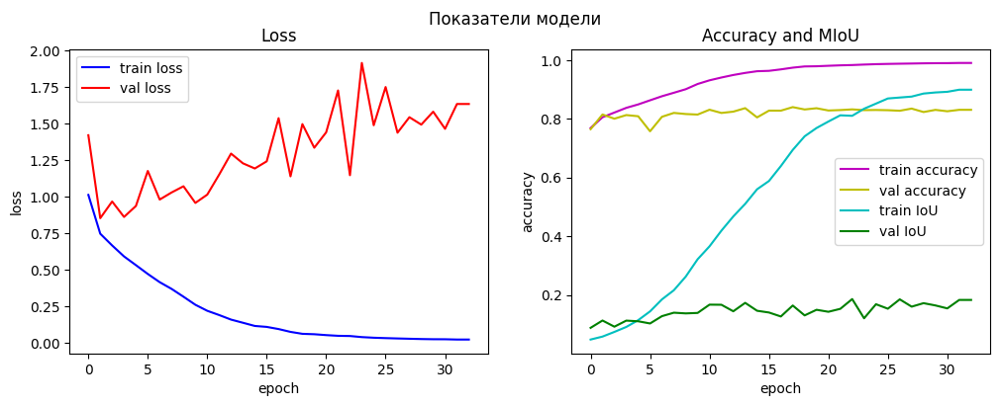

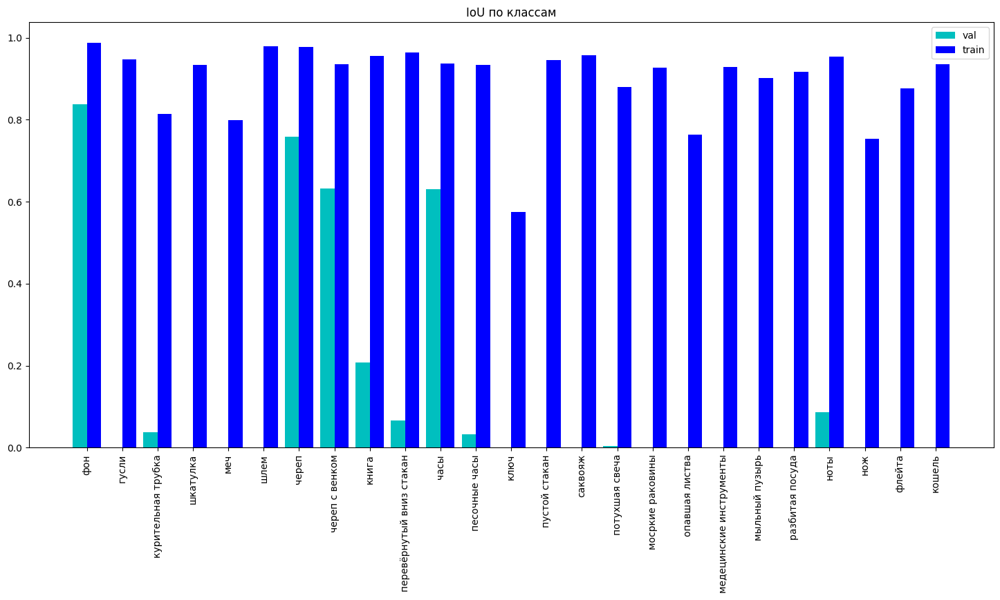

In [35]:
grafics([skeleton_history1, skeleton_history1_1, skeleton_history2, skeleton_history2_1], skeleton_history2_1)

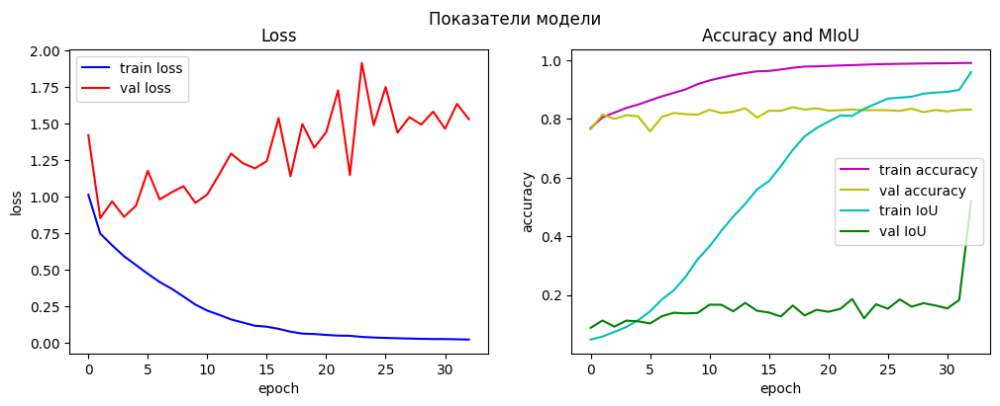

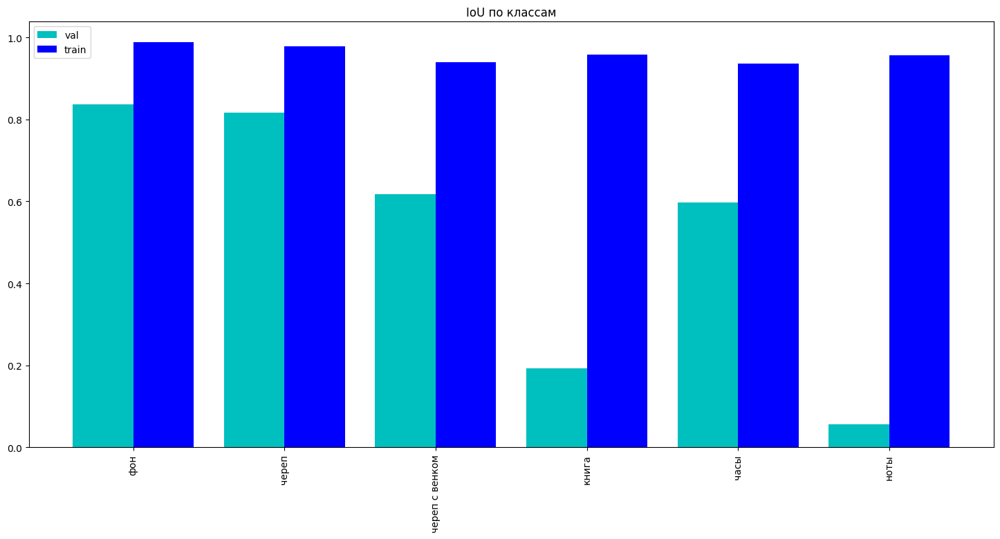

In [33]:
grafics([skeleton_history1, skeleton_history1_1, skeleton_history2, skeleton_history2_1, skeleton_history3_1], skeleton_history3_1)

In [34]:
def infer(model, image_tensor):
    predictions = model.predict(np.expand_dims((image_tensor), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    return predictions

def decode_segmentation_masks(mask, colormap, n_classes):
    r = np.zeros_like(mask).astype(np.uint8)
    g = np.zeros_like(mask).astype(np.uint8)
    b = np.zeros_like(mask).astype(np.uint8)
    for l in range(0, n_classes):
        idx = mask == l
        r[idx] = colormap[l][0]
        g[idx] = colormap[l][1]
        b[idx] = colormap[l][2]
    rgb = np.stack([r, g, b], axis=2)
    return rgb


def get_overlay(image, colored_mask):
    image = tf.keras.preprocessing.image.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    overlay = cv2.addWeighted(image, 0.35, colored_mask, 0.65, 0)
    return overlay


def plot_samples_matplotlib(display_list, figsize=(5, 3)):
    _, axes = plt.subplots(nrows=1, ncols=len(display_list), figsize=figsize)
    for i in range(len(display_list)):
        if display_list[i].shape[-1] == 3:
            axes[i].imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        else:
            axes[i].imshow(display_list[i])
    plt.show()


def plot_predictions(images_list, colormap, model):
    for image_file in images_list:
        image_tensor = read_image(image_path = image_file)[0]
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, len(COLORMAP))
        image_tensor = read_image(image_path = image_file, presentation = True)[0]
        overlay = get_overlay(image_tensor, prediction_colormap)
        plot_samples_matplotlib(
            [image_tensor, overlay, prediction_colormap], figsize=(18, 14)
        )

In [35]:
model_tables = keras.models.load_model('D:\\model_tables2')
model_skeletons = keras.models.load_model('D:\\model_skeletons2')
model_flowers = keras.models.load_model('D:\\model_flowers2')

In [29]:
images = sorted(glob(os.path.join(DATA_DIR[NUMBER], "train\\img/*")))
masks = sorted(glob(os.path.join(DATA_DIR[NUMBER], "train\\lbl/*")))

def plot_for_testing(images, masks):
    for i in range(len(images)):
        image = cv2.imread(images[i])
        image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))
        mask = cv2.imread(masks[i])
        mask = cv2.resize(mask, (IMAGE_SIZE, IMAGE_SIZE), interpolation=cv2.INTER_NEAREST)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
        overlay = cv2.addWeighted(image, 0.35, mask, 0.65, 0)
        _, axes = plt.subplots(nrows=1, ncols=3, figsize=(10, 6))
        axes[0].imshow(image)
        axes[1].imshow(overlay)
        axes[2].imshow(mask)
        plt.show()

.\flowers\train\img\43) Flower still life in a glass vase in front of a niche with butterfly, lizard, fly and dragonfly (Balthasar van der Ast).jpg
1/1 [==============================] - 2s 2s/step
.\flowers\train\img\43) Flower still life in a glass vase in front of a niche with butterfly, lizard, fly and dragonfly (Balthasar van der Ast).jpg


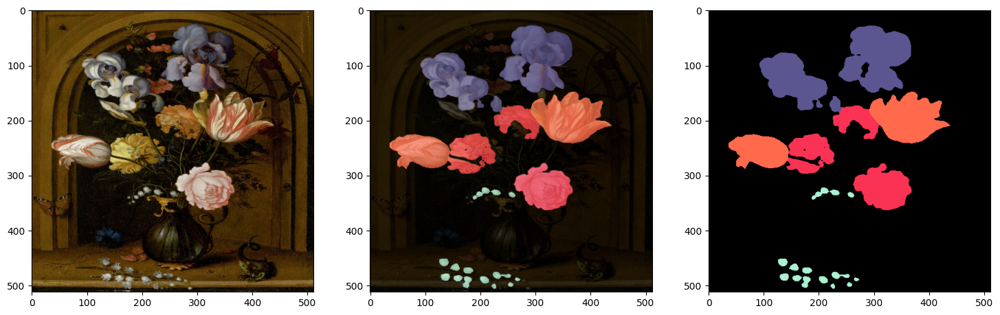

.\flowers\train\img\44) Flower still-life with shell and insects (Balthasar van der Ast).jpg
1/1 [==============================] - 1s 633ms/step
.\flowers\train\img\44) Flower still-life with shell and insects (Balthasar van der Ast).jpg


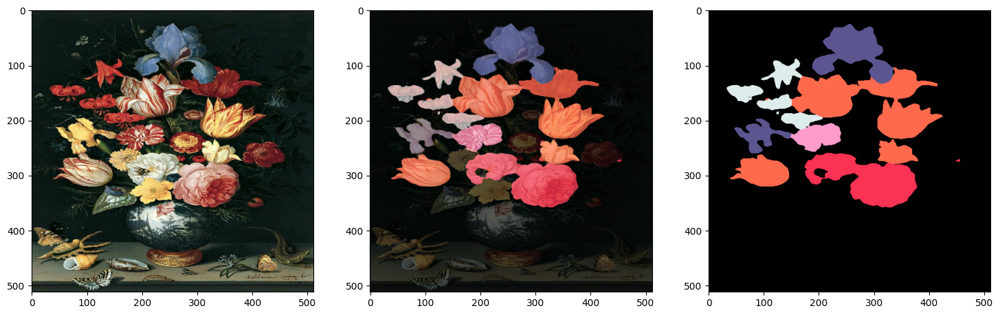

.\flowers\train\img\45) Vase with flowers, beetle and redcurrant (Balthasar van der Ast).jpg
1/1 [==============================] - 1s 679ms/step
.\flowers\train\img\45) Vase with flowers, beetle and redcurrant (Balthasar van der Ast).jpg


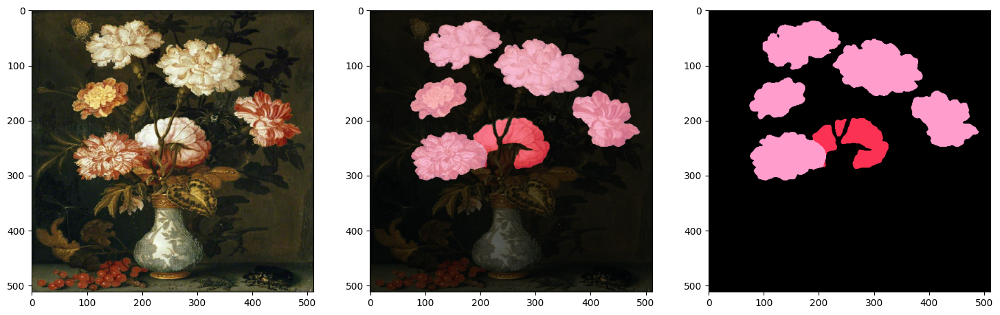

.\flowers\train\img\46) Flower still life (Coenraet Roephel).jpg
1/1 [==============================] - 1s 633ms/step
.\flowers\train\img\46) Flower still life (Coenraet Roephel).jpg


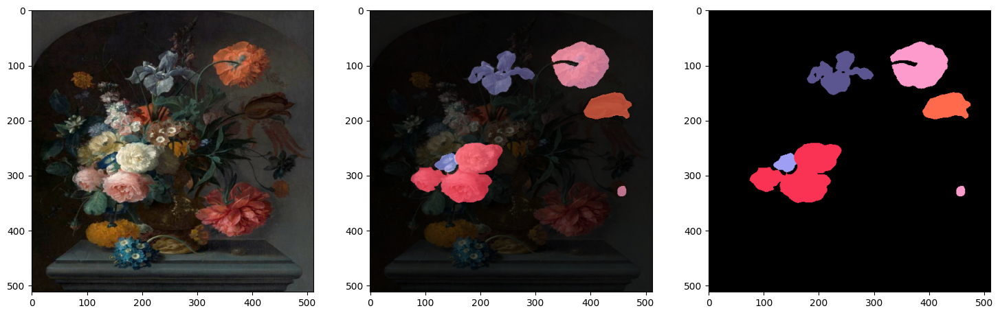

.\flowers\train\img\47) Flower still life in a stone vase on a stone pedestal with a relief (Coenraet Roephel).jpg
1/1 [==============================] - 1s 663ms/step
.\flowers\train\img\47) Flower still life in a stone vase on a stone pedestal with a relief (Coenraet Roephel).jpg


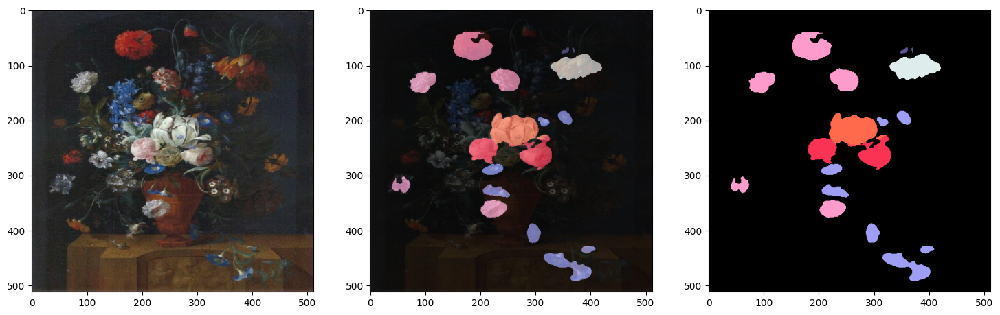

In [37]:
plot_predictions(train_images[35:40], COLORMAP, model_flowers)

.\flowers\val\img\1) Bouquet of flowers in a vase with a bird's nest and a butterfly (Joseph Lauer).jpg
1/1 [==============================] - 1s 918ms/step
.\flowers\val\img\1) Bouquet of flowers in a vase with a bird's nest and a butterfly (Joseph Lauer).jpg


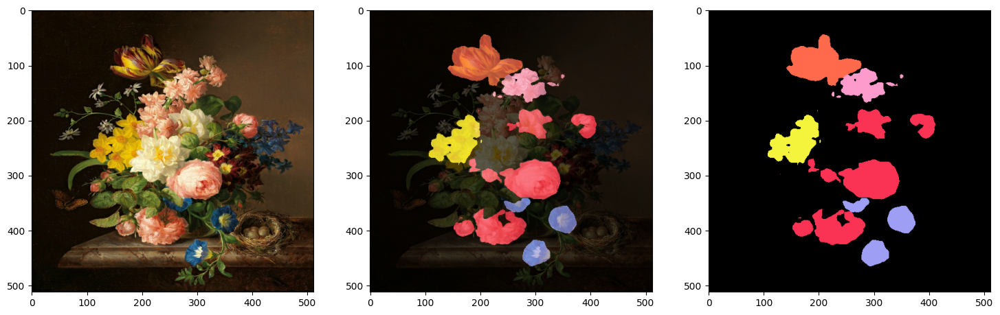

.\flowers\val\img\3) Flower still life (Jacob Marrel).jpg
1/1 [==============================] - 1s 662ms/step
.\flowers\val\img\3) Flower still life (Jacob Marrel).jpg


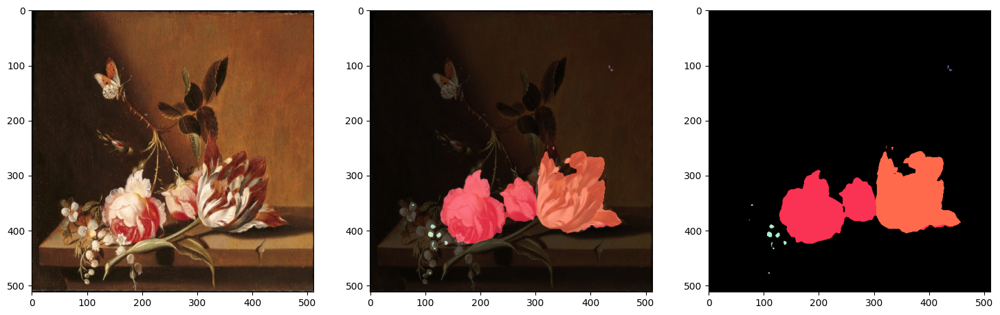

.\flowers\val\img\4) Still life with flowers and fruit on a marble ledge (Paulus Theodor van Brussels).jpg
1/1 [==============================] - 1s 708ms/step
.\flowers\val\img\4) Still life with flowers and fruit on a marble ledge (Paulus Theodor van Brussels).jpg


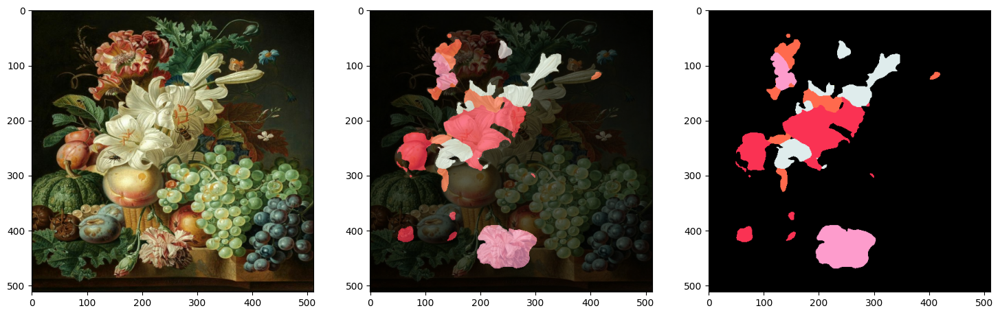

.\flowers\val\img\53)Still-life-with-flowers_-fruit-and-a-vase-on-a-marble-ledge-_Gerard-van-Spaendonck_.jpg
1/1 [==============================] - 1s 637ms/step
.\flowers\val\img\53)Still-life-with-flowers_-fruit-and-a-vase-on-a-marble-ledge-_Gerard-van-Spaendonck_.jpg


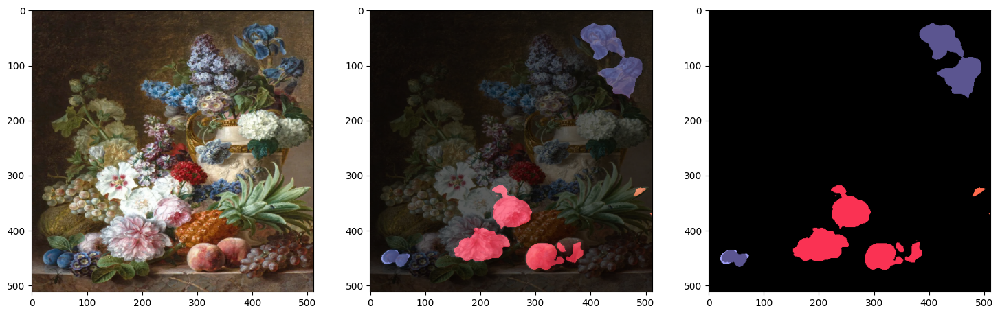

.\flowers\val\img\85)Still-life-with-roses_-peonies-and-lilac-_Adriana-Johanna-Haanen_.jpg
1/1 [==============================] - 1s 690ms/step
.\flowers\val\img\85)Still-life-with-roses_-peonies-and-lilac-_Adriana-Johanna-Haanen_.jpg


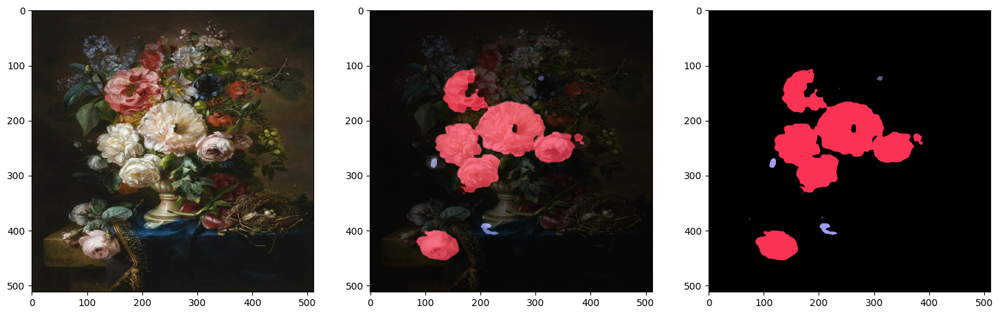

In [38]:
plot_predictions(val_images, COLORMAP, model_flowers)

.\tables\train\img\39.jpg
1/1 [==============================] - 2s 2s/step
.\tables\train\img\39.jpg


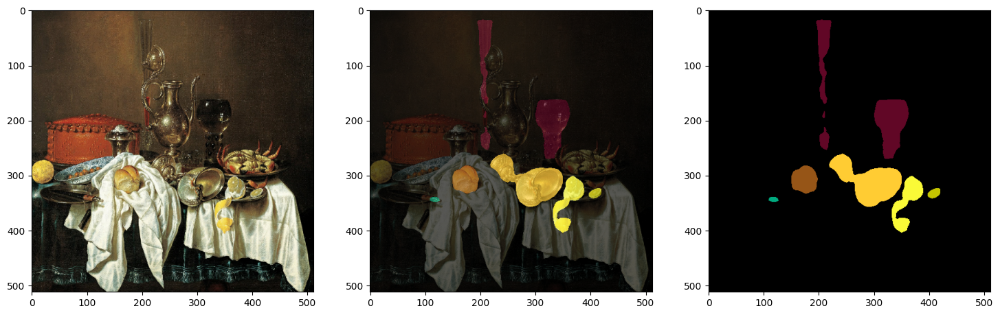

.\tables\train\img\4.jpg
1/1 [==============================] - 1s 697ms/step
.\tables\train\img\4.jpg


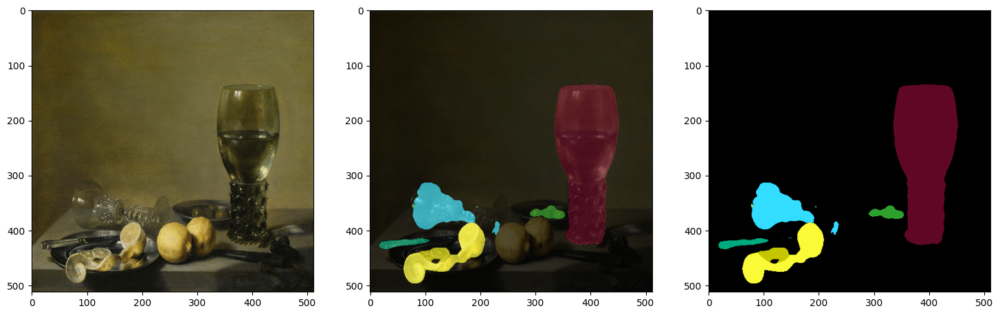

.\tables\train\img\40.jpg
1/1 [==============================] - 1s 654ms/step
.\tables\train\img\40.jpg


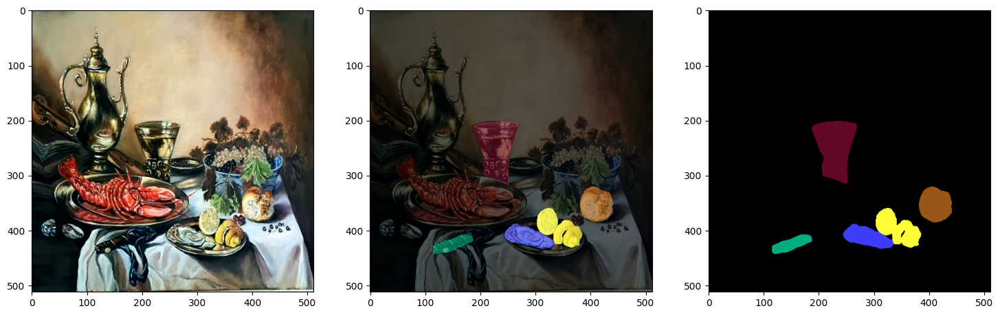

.\tables\train\img\41.jpg
1/1 [==============================] - 1s 648ms/step
.\tables\train\img\41.jpg


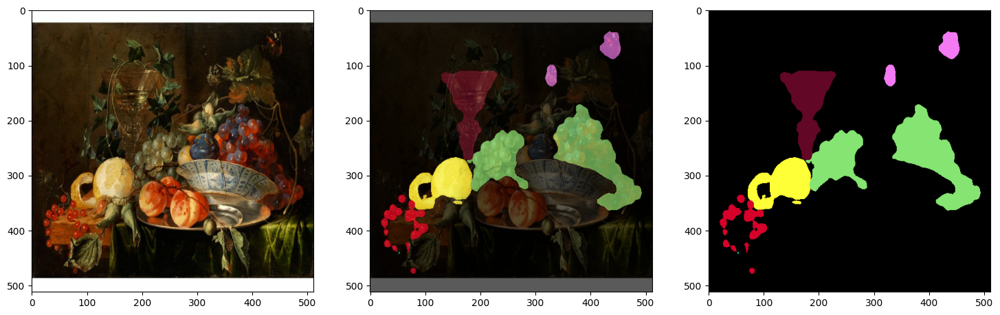

.\tables\train\img\42.jpg
1/1 [==============================] - 1s 663ms/step
.\tables\train\img\42.jpg


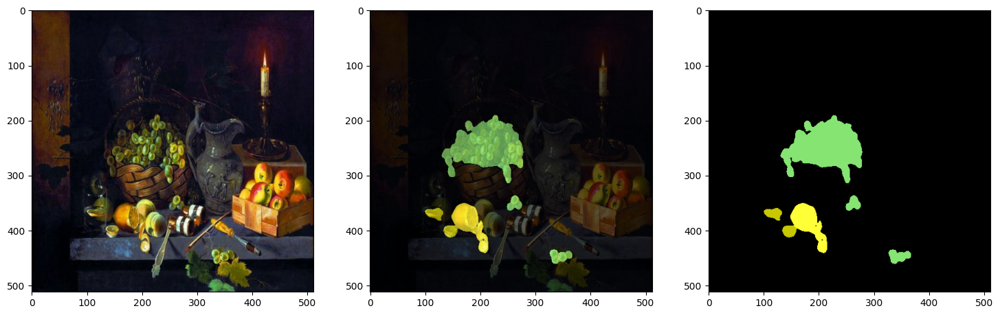

In [17]:
plot_predictions(train_images[35:40], COLORMAP, model_tables)

.\tables\val\img\102.jpg
1/1 [==============================] - 3s 3s/step
.\tables\val\img\102.jpg


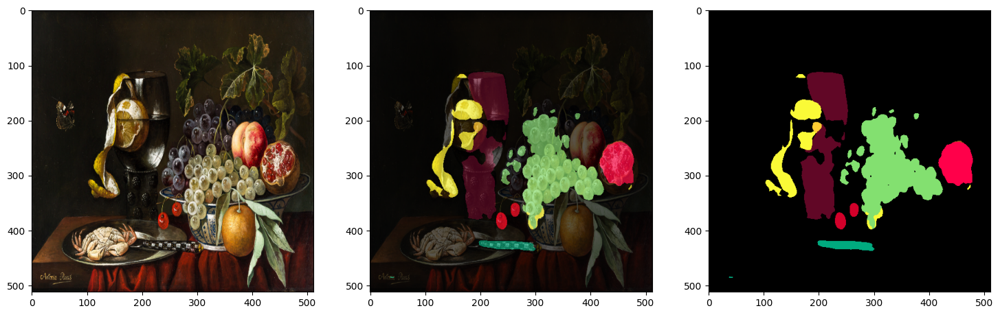

.\tables\val\img\26.jpg
1/1 [==============================] - 1s 642ms/step
.\tables\val\img\26.jpg


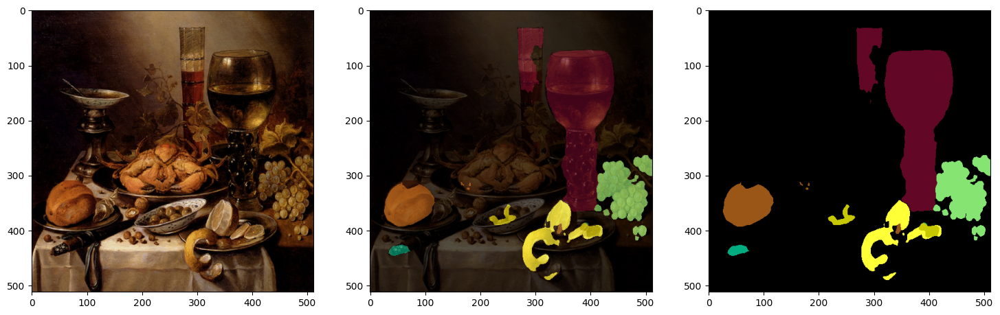

.\tables\val\img\61.jpg
1/1 [==============================] - 1s 675ms/step
.\tables\val\img\61.jpg


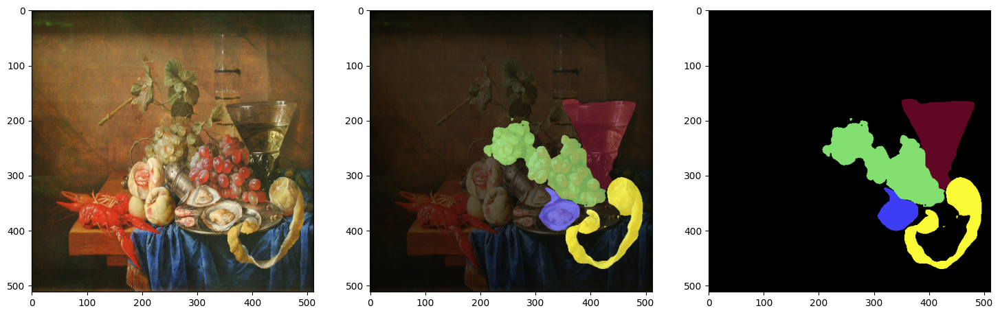

.\tables\val\img\78.jpg
1/1 [==============================] - 1s 632ms/step
.\tables\val\img\78.jpg


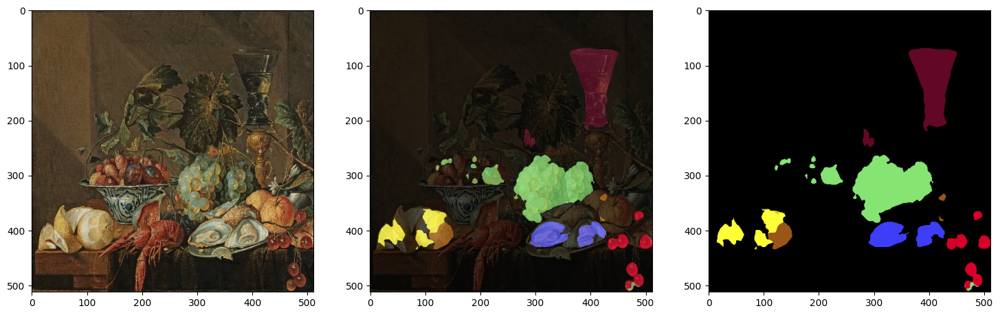

.\tables\val\img\94.jpg
1/1 [==============================] - 1s 656ms/step
.\tables\val\img\94.jpg


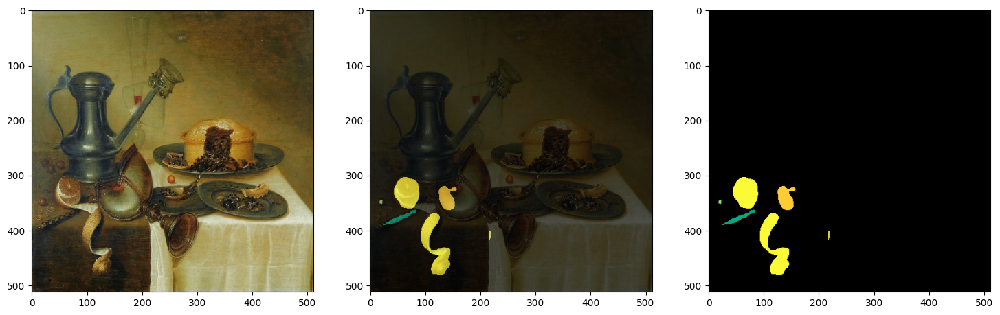

In [15]:
plot_predictions(val_images, COLORMAP, model_tables)

.\skeletons\train\img\27.jpg
1/1 [==============================] - 2s 2s/step
.\skeletons\train\img\27.jpg


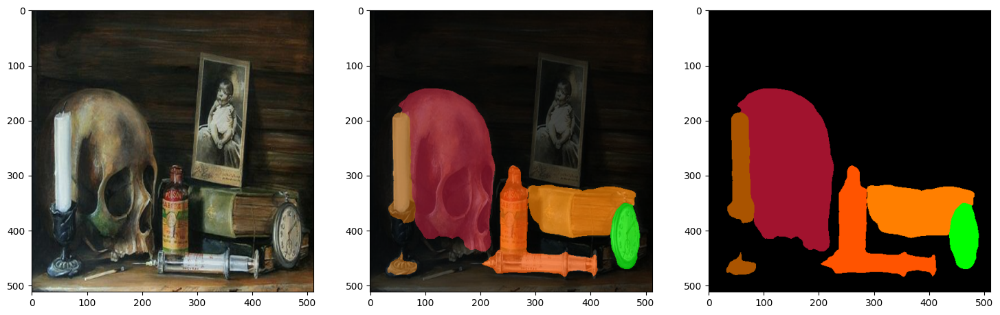

.\skeletons\train\img\28.jpg
1/1 [==============================] - 1s 642ms/step
.\skeletons\train\img\28.jpg


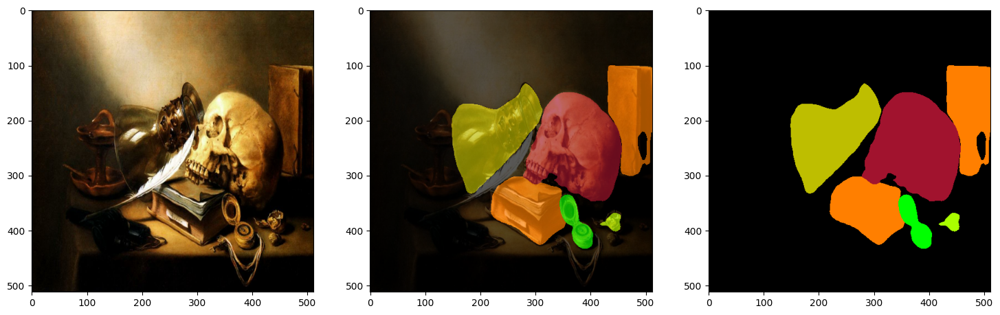

.\skeletons\train\img\29.jpg
1/1 [==============================] - 1s 645ms/step
.\skeletons\train\img\29.jpg


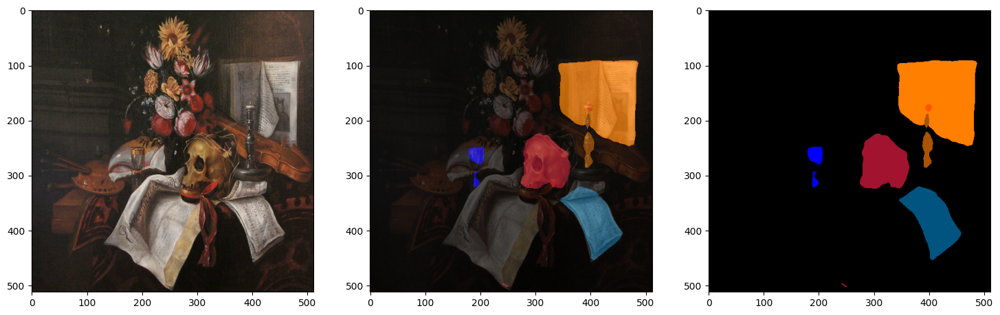

.\skeletons\train\img\3.jpeg
1/1 [==============================] - 1s 679ms/step
.\skeletons\train\img\3.jpeg


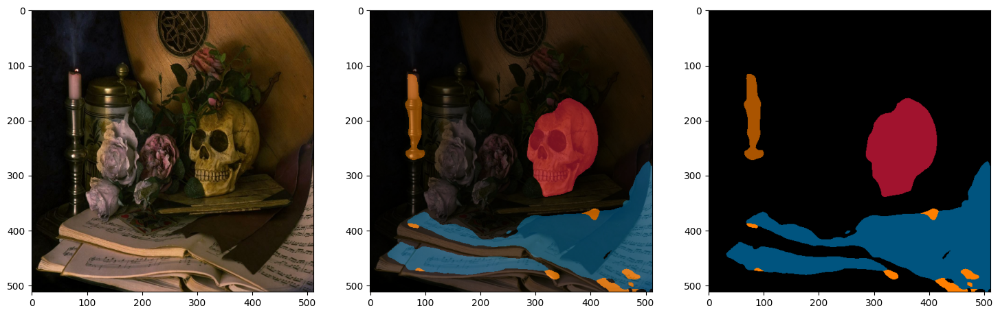

In [20]:
plot_predictions(train_images[20:24], COLORMAP, model_skeletons)

.\skeletons\val\img\21.jpg
1/1 [==============================] - 2s 2s/step
.\skeletons\val\img\21.jpg


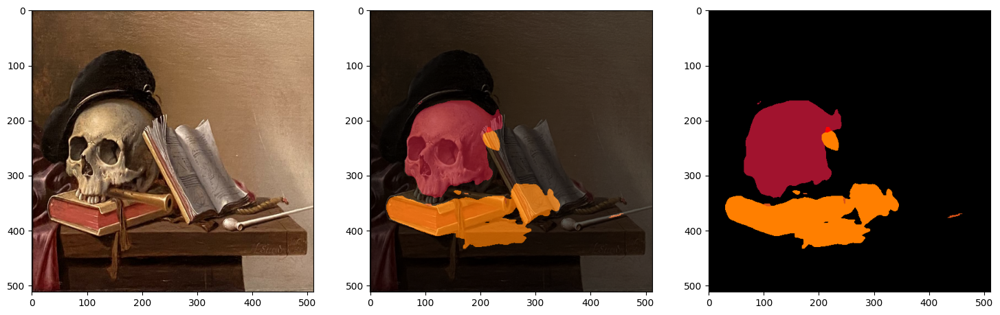

.\skeletons\val\img\38.jpg
1/1 [==============================] - 1s 676ms/step
.\skeletons\val\img\38.jpg


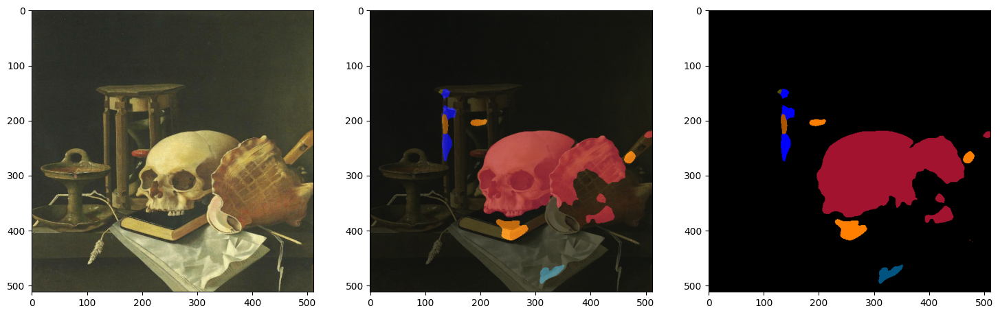

.\skeletons\val\img\49.jpeg
1/1 [==============================] - 1s 677ms/step
.\skeletons\val\img\49.jpeg


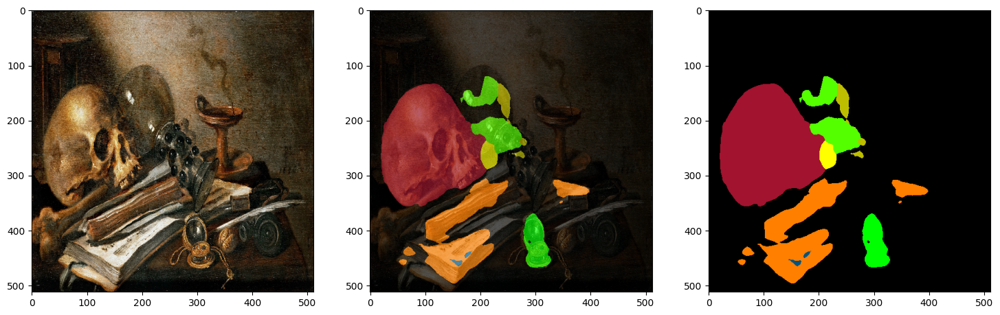

.\skeletons\val\img\79.jpg
1/1 [==============================] - 1s 687ms/step
.\skeletons\val\img\79.jpg


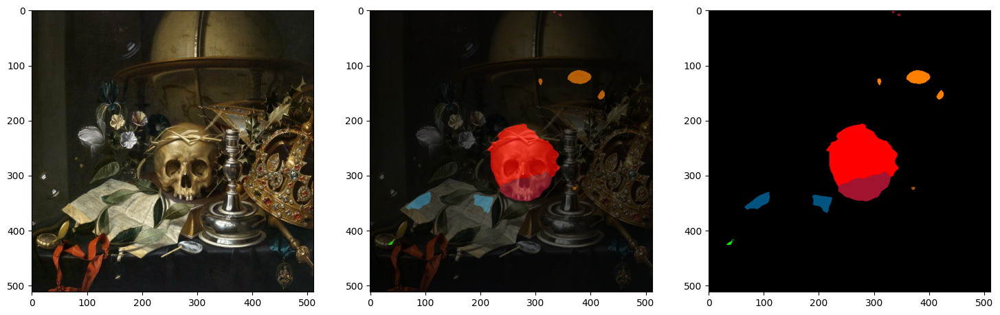

In [15]:
plot_predictions(val_images, COLORMAP, model_skeletons)